In [1]:
import os

import pandas as pd
import scipy.stats as sts

In [2]:
from pathlib import Path
from itertools import product
from collections import Counter

In [3]:
import plotly.express as px

In [4]:
from oktmo_names import oktmo_names_decode as oktmo_names

In [5]:
PATH_DATA = os.path.join(Path.cwd(), 'data')
PATH_SUBM = os.path.join(Path.cwd(), 'submissions')

# Подготовка данных

In [8]:
#train = pd.read_csv(os.path.join(PATH_DATA, 'train_orig.csv'), sep = ';', encoding = 'utf-8', engine='python')
train = pd.read_csv(os.path.join(PATH_DATA, 'train.csv'),
                    sep = ';',
                    parse_dates=['date'],
                    infer_datetime_format=True,
                    decimal = ',',
                    thousands='\xa0',
                    engine='python',
                   )
train.shape

(60193, 79)

In [9]:
train.tail()

,region,oktmo,okato,date,pasta,legumes,bread,flour,rice,groats,...,spice_value,tea_value,ai92,ai95,ai98,dt,ai92_value,ai95_value,ai98_value,dt_value
60188,77,45000000000,45000000000,2019-04-23,113.15,122.36,87.90,38.23,92.69,67.55,...,270462.20,319657.27,41.99,46.14,51.38,45.57,2381368.50,3426446.00,8797.52,1198798.50
60189,79,99000000000,99000000000,2019-04-23,65.44,99.11,72.33,30.52,54.67,35.67,...,1511.96,913.00,42.54,44.45,44.95,48.12,19659.81,13577.01,495.42,6244.61
60190,83,11800000000,11100000000,2019-04-23,101.84,170.51,71.96,0.00,103.79,84.96,...,856.69,733.00,45.28,49.03,0.00,53.34,15447.19,3541.17,0.00,2039.00
60191,78,40000000000,40000000000,2019-04-23,88.65,110.52,101.44,35.46,82.80,60.47,...,149387.58,183308.42,42.26,44.93,52.03,46.07,1462154.50,1834983.50,18510.21,740172.75
60192,54,50000000000,50000000000,2019-04-23,68.10,87.81,63.27,27.84,70.36,47.01,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


данные за 2019-04-23 предоставлены единичными регионами.   
отсечем их для простоты дальнейшей обработки и исследования

In [10]:
first_day = train.date.min()
train.drop(train.query('date == @first_day').index, 
           axis = 0, inplace = True)

In [11]:
items = train.columns.drop(['region', 'oktmo', 'okato', 'date'])
items

Index(['pasta', 'legumes', 'bread', 'flour', 'rice', 'groats', 'potatoes',
       'сucumbers_tomatoes', 'vegetables', 'roots', 'сabbage', 'fruit',
       'sugar', 'candy', 'biscuits', 'mutton', 'beef', 'chicken', 'pork',
       'fish', 'herring', 'curd', 'sour_creame', 'butter', 'milk_kefir',
       'cheese', 'egg', 'margarine', 'oil', 'salt', 'spice', 'tea', 'cpi_1',
       'cpi_2', 'cpi_3', 'pasta_value', 'legumes_value', 'bread_value',
       'flour_value', 'rice_value', 'groats_value', 'potatoes_value',
       'сucumbers_tomatoes_value', 'vegetables_value', 'roots_value',
       'сabbage_value', 'fruit_value', 'sugar_value', 'candy_value',
       'biscuits_value', 'mutton_value', 'beef_value', 'chicken_value',
       'pork_value', 'fish_value', 'herring_value', 'curd_value',
       'sour_creame_value', 'butter_value', 'milk_kefir_value', 'cheese_value',
       'egg_value', 'margarine_value', 'oil_value', 'salt_value',
       'spice_value', 'tea_value', 'ai92', 'ai95', 'ai98', 'dt',

~~в исходных данных в числах с плавающей запятой запятая, вместо необходимой для python точки.    
преобразуем, приводим к float~~

In [12]:
###lambda_dot = lambda x: x.replace(',', '.').replace(u'\xa0', u'')

In [13]:
for el in items:
    ###train[el] = train[el].map(lambda_dot).astype(float)
    train[el] = train[el].astype(float)

In [14]:
train['weekday'] = train.date.map(lambda x: x.weekday())
train.weekday.value_counts()

2    8670
0    8585
1    8585
3    8585
4    8585
5    8585
6    8585
Name: weekday, dtype: int64

In [15]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 60180 entries, 0 to 60179
Data columns (total 80 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   region                    60180 non-null  int64         
 1   oktmo                     60180 non-null  int64         
 2   okato                     60180 non-null  int64         
 3   date                      60180 non-null  datetime64[ns]
 4   pasta                     60180 non-null  float64       
 5   legumes                   60180 non-null  float64       
 6   bread                     60180 non-null  float64       
 7   flour                     60180 non-null  float64       
 8   rice                      60180 non-null  float64       
 9   groats                    60180 non-null  float64       
 10  potatoes                  60180 non-null  float64       
 11  сucumbers_tomatoes        60180 non-null  float64       
 12  vegetables        

In [16]:
regs = train.region.unique()
regs

array([72, 75, 74, 73, 65, 66, 64, 67, 79, 77, 78, 83, 76, 51, 52, 54, 53,
       30, 32, 31, 33, 91, 89, 86, 87,  2,  4,  1,  3,  5,  8,  7,  6, 14,
       16, 15, 17, 13, 20, 18, 19,  9, 11, 10, 12, 23, 24, 21, 25, 63, 62,
       61, 60, 41, 39, 42, 40, 46, 44, 45, 43, 92, 69, 70, 71, 68, 47, 50,
       49, 48, 29, 28, 27, 26, 37, 35, 34, 36, 38, 57, 55, 56, 58, 59],
      dtype=int64)

In [17]:
oktmo = train.oktmo.unique()
oktmo

array([71000000000, 76000000000, 75000000000, 73000000000, 64000000000,
       65000000000, 63000000000, 66000000000, 99000000000, 45000000000,
       40000000000, 11800000000, 78000000000, 47000000000, 22000000000,
       50000000000, 49000000000, 12000000000, 15000000000, 14000000000,
       17000000000, 35000000000, 71900000000, 71800000000, 77000000000,
       80000000000, 84000000000, 79000000000, 81000000000, 82000000000,
       85000000000, 83000000000, 26000000000, 98000000000, 92000000000,
       90000000000, 93000000000, 89000000000, 96000000000, 94000000000,
       95000000000, 91000000000, 87000000000, 86000000000, 88000000000,
        3000000000,  4000000000, 97000000000,  1000000000,  5000000000,
       36000000000, 61000000000, 60000000000, 58000000000, 30000000000,
       27000000000, 32000000000, 29000000000, 38000000000, 34000000000,
       37000000000, 33000000000, 67000000000, 28000000000, 69000000000,
       70000000000, 68000000000, 41000000000, 46000000000, 44000

In [18]:
items = train.columns.drop(['region', 'oktmo', 'okato', 'date'])
items

Index(['pasta', 'legumes', 'bread', 'flour', 'rice', 'groats', 'potatoes',
       'сucumbers_tomatoes', 'vegetables', 'roots', 'сabbage', 'fruit',
       'sugar', 'candy', 'biscuits', 'mutton', 'beef', 'chicken', 'pork',
       'fish', 'herring', 'curd', 'sour_creame', 'butter', 'milk_kefir',
       'cheese', 'egg', 'margarine', 'oil', 'salt', 'spice', 'tea', 'cpi_1',
       'cpi_2', 'cpi_3', 'pasta_value', 'legumes_value', 'bread_value',
       'flour_value', 'rice_value', 'groats_value', 'potatoes_value',
       'сucumbers_tomatoes_value', 'vegetables_value', 'roots_value',
       'сabbage_value', 'fruit_value', 'sugar_value', 'candy_value',
       'biscuits_value', 'mutton_value', 'beef_value', 'chicken_value',
       'pork_value', 'fish_value', 'herring_value', 'curd_value',
       'sour_creame_value', 'butter_value', 'milk_kefir_value', 'cheese_value',
       'egg_value', 'margarine_value', 'oil_value', 'salt_value',
       'spice_value', 'tea_value', 'ai92', 'ai95', 'ai98', 'dt',

## Графики

In [19]:
def graph_research(inp_item):
    print(inp_item)
    
    use_cols = ['oktmo', 'date'] + [inp_item]
    Xsum = train[use_cols].groupby('date').sum().sort_values(by='date')
    fig = px.line(y = Xsum[inp_item], x = Xsum.index)
    fig.show()
    
    Xaver = train[use_cols].groupby('date').mean().sort_values(by='date')
    
    #for reg_id in regs[0:10]:
    for reg_id in oktmo:
        print(oktmo_names[reg_id])
        
        X = train[use_cols].query('oktmo == @reg_id').sort_values(by='date')
        
        #fig = px.box(x = Xaver.index)
        fig = px.line(y = X[inp_item], x = X.date)#, title='region vs aver')
        fig.add_scatter(y = Xaver[inp_item], x = Xaver.index, name = 'aver')
        #fig.add_scatter(y = Xaver[inp_item], x = Xaver.index, name = 'aver')
        fig.show()
        

pasta


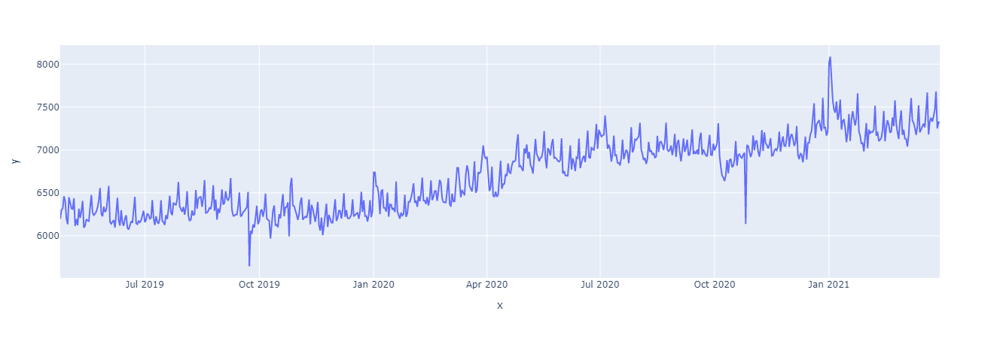

Муниципальные образования Тюменской области


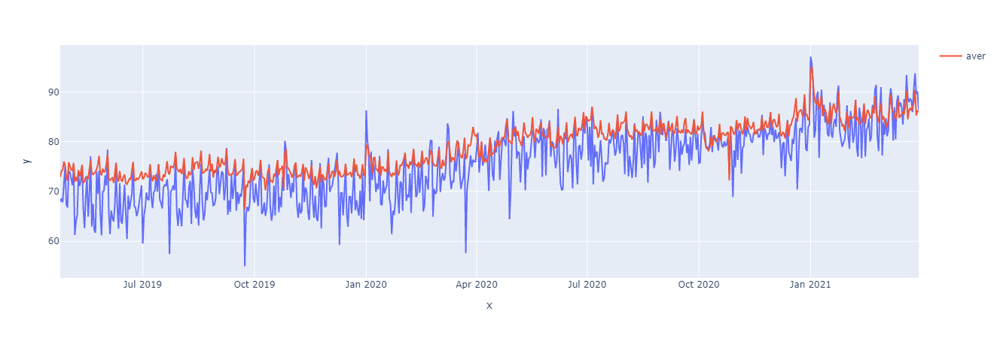

Муниципальные образования Забайкальского края


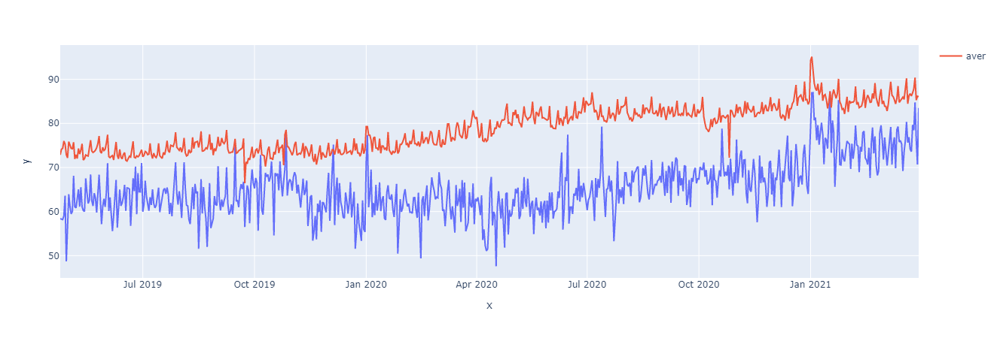

Муниципальные образования Челябинской области


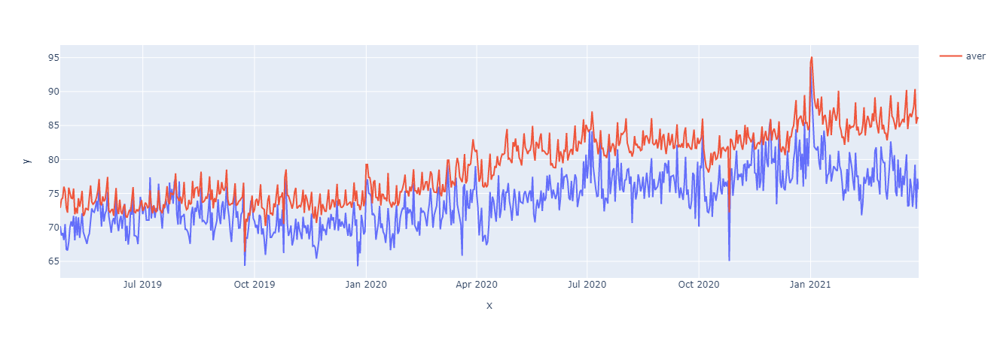

Муниципальные образования Ульяновской области


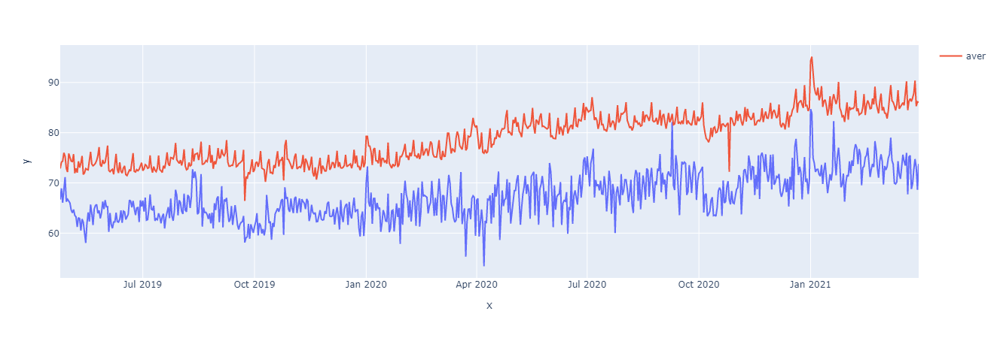

Муниципальные образования Сахалинской области


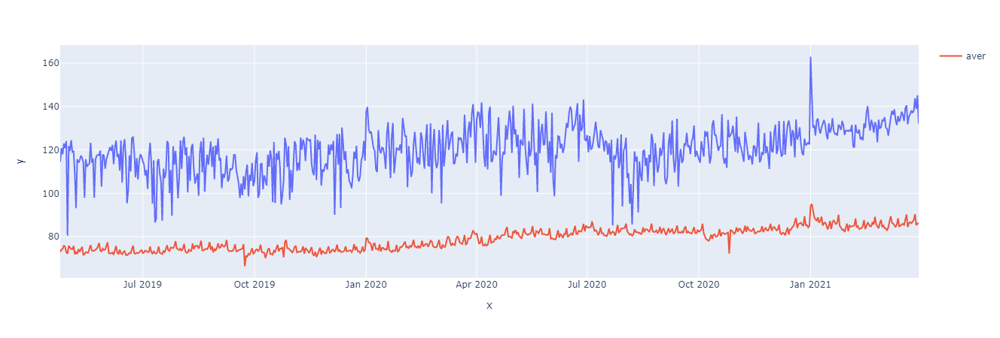

Муниципальные образования Свердловской области


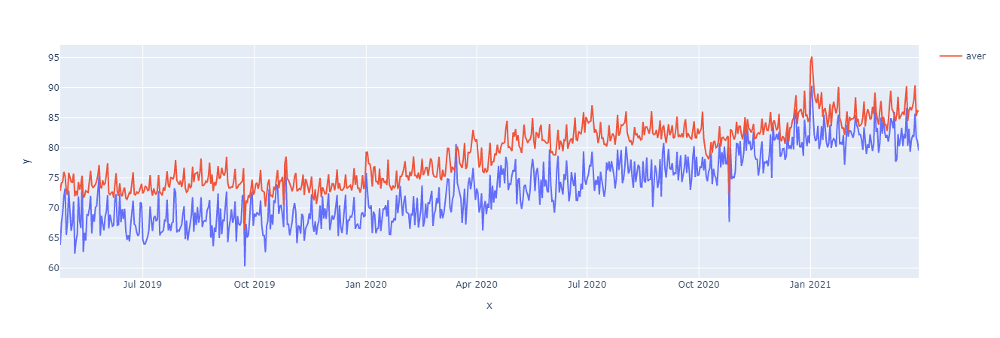

Муниципальные образования Саратовской области


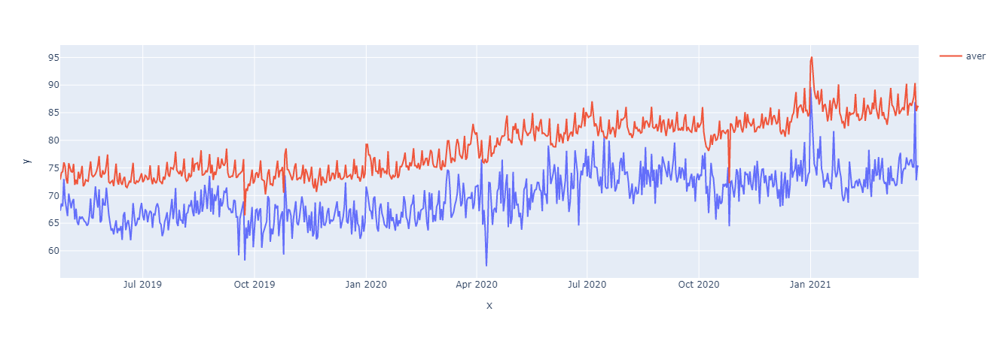

Муниципальные образования Смоленской области


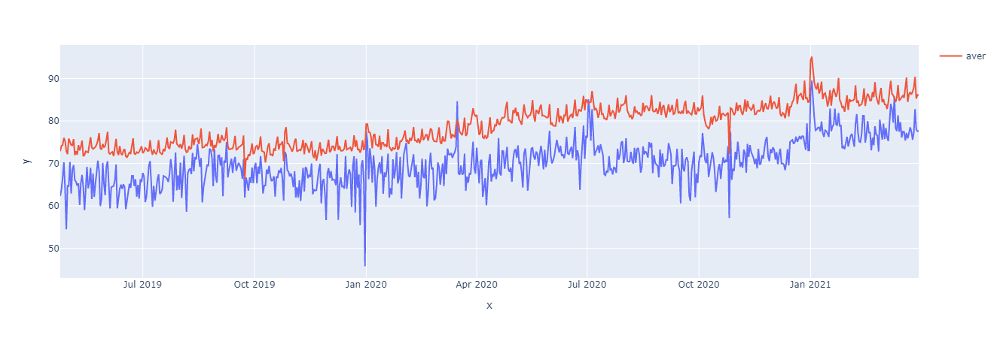

Муниципальные образования Еврейской автономной области


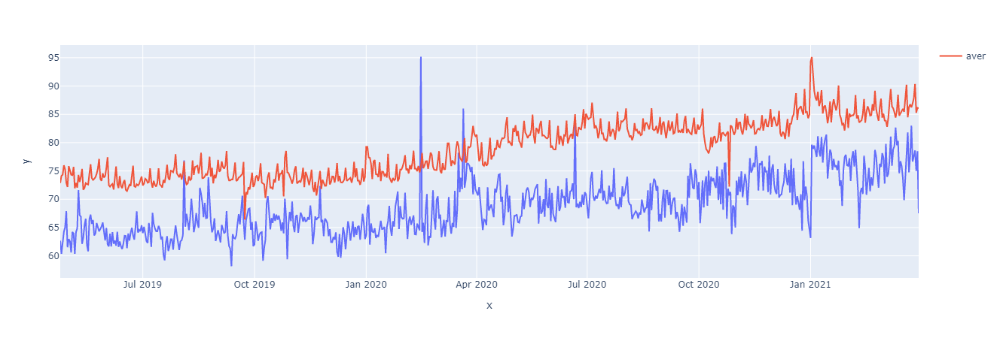

Муниципальные образования города Москвы (столицы Российской Федерации города федерального значения)


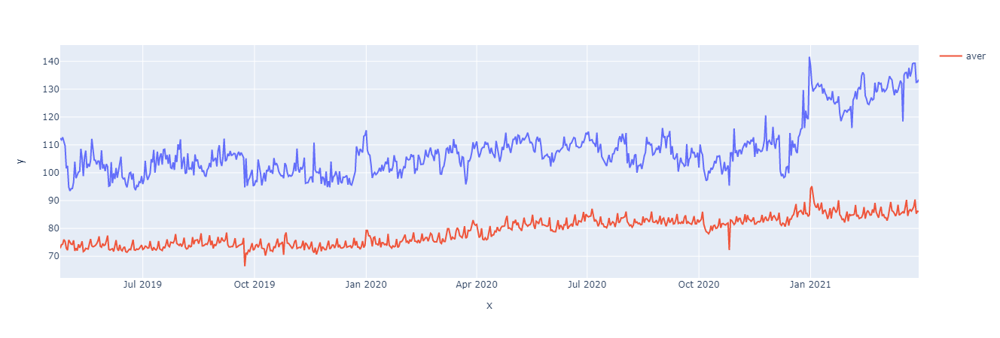

Муниципальные образования Города Санкт-Петербурга (города федерального значения)


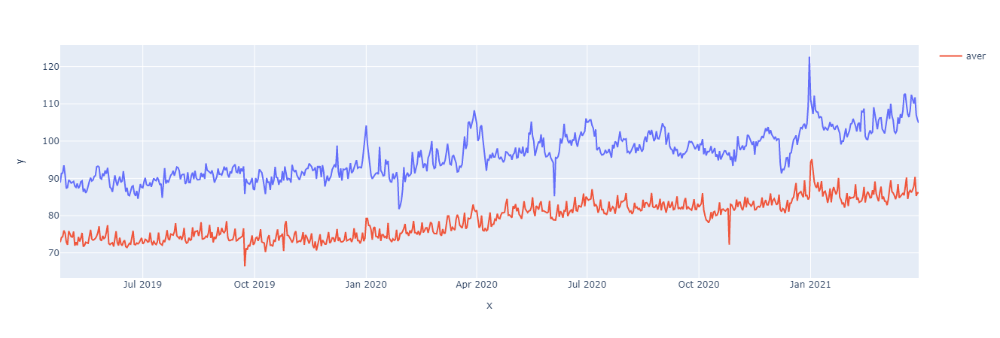

Муниципальные образования Ненецкого автономного округа


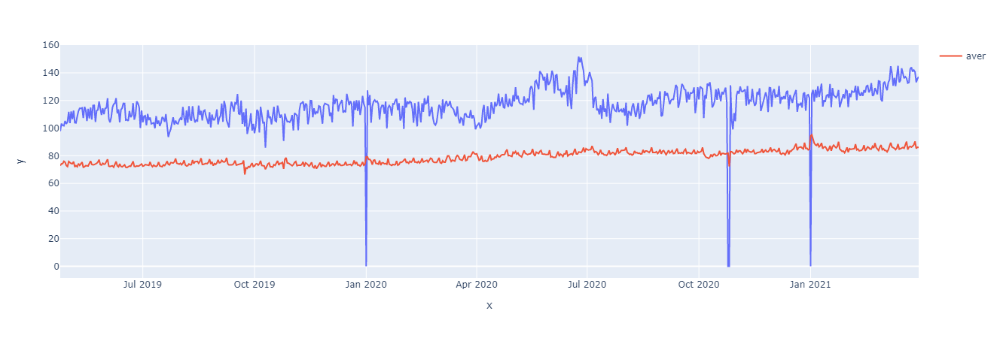

Муниципальные образования Ярославской области


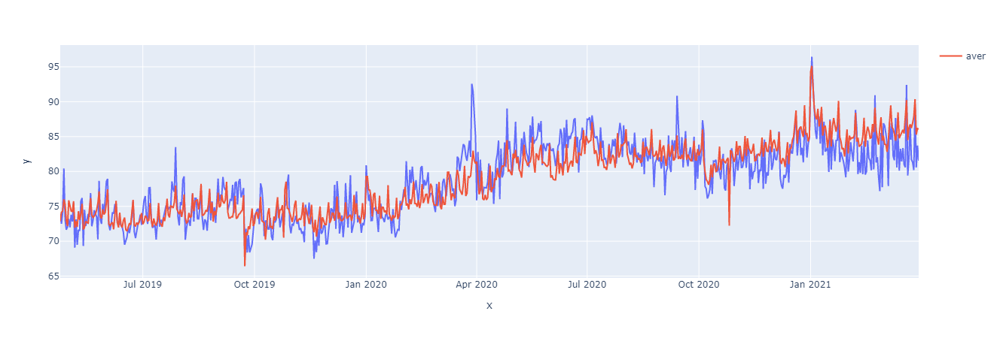

Муниципальные образования Мурманской области


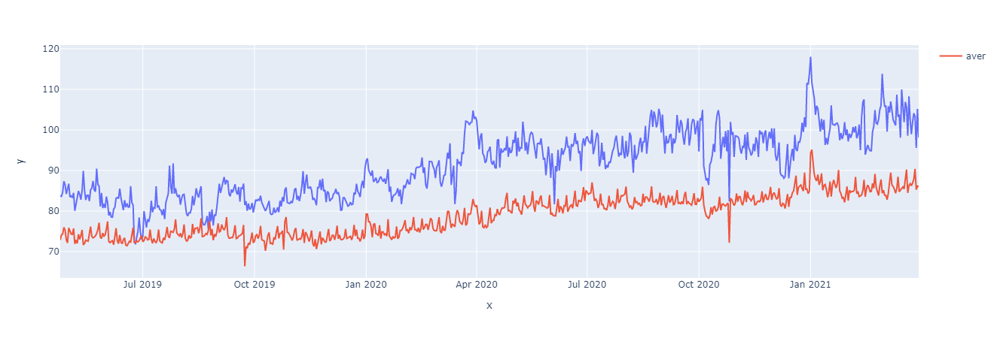

Муниципальные образования Нижегородской области


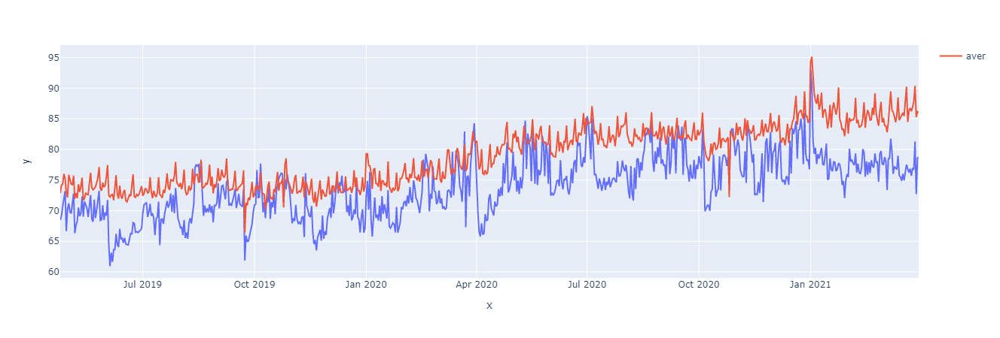

Муниципальные образования Новосибирской области


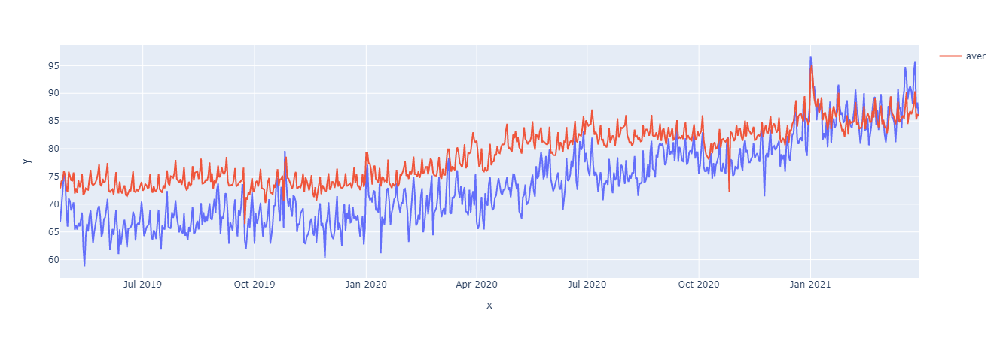

Муниципальные образования Новгородской области


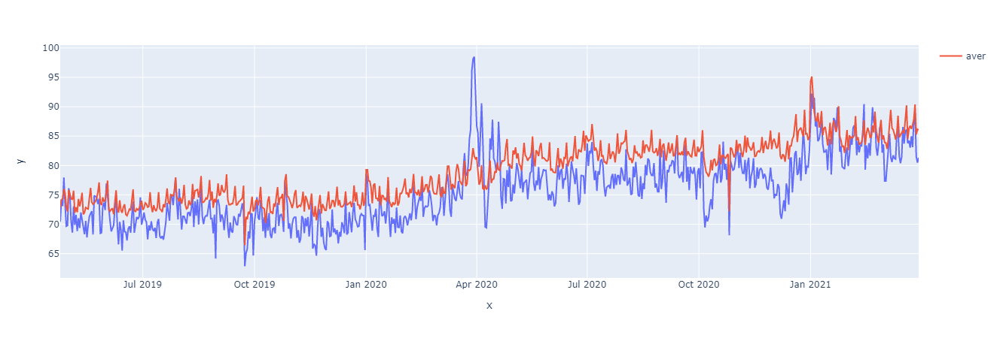

Муниципальные образования Астраханской области


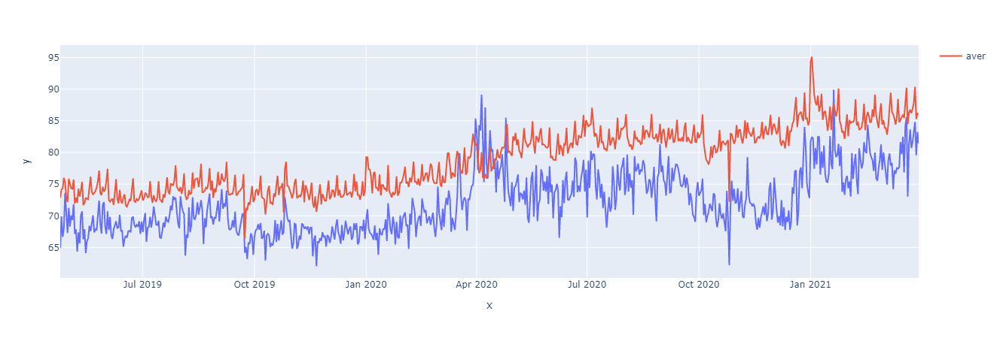

Муниципальные образования Брянской области


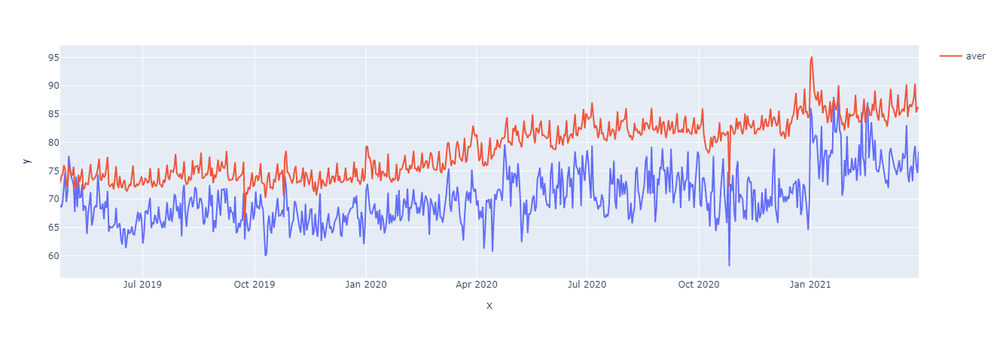

Муниципальные образования Белгородской области


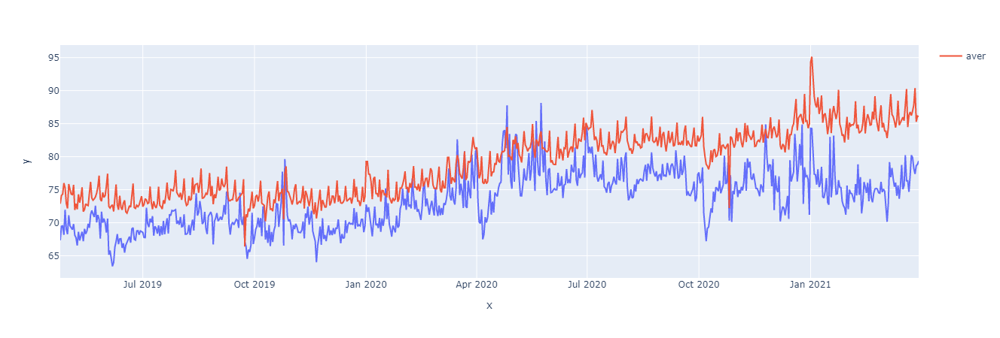

Муниципальные образования Владимирской области


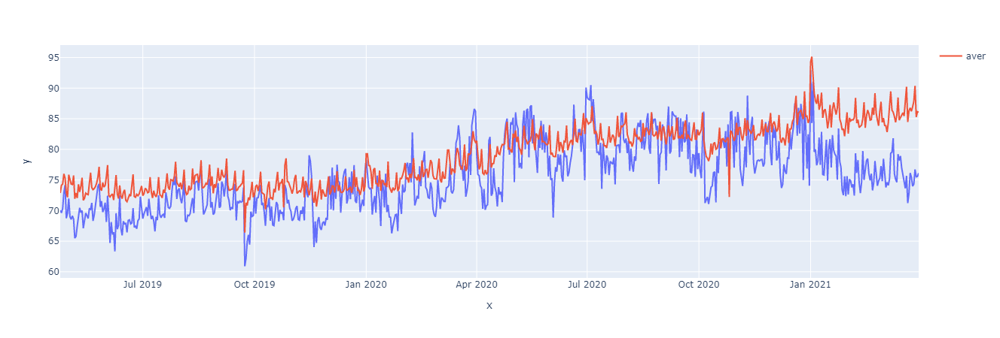

Муниципальные образования Республики Крым


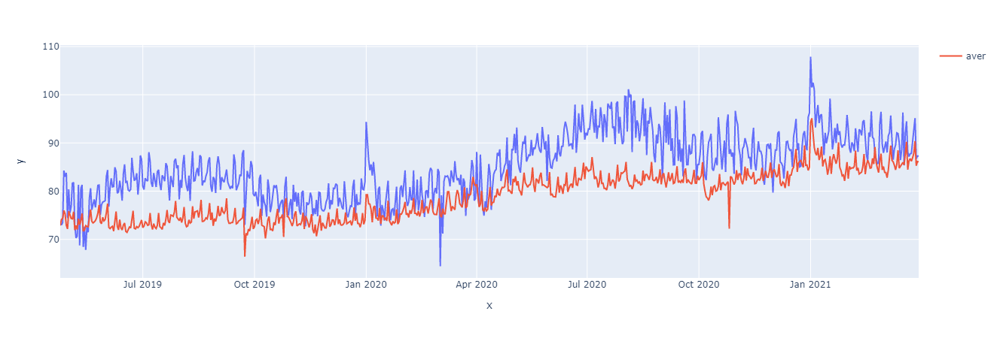

Муниципальные районы, муниципальные округа, городские округа Ямало-Ненецкого автономного округа


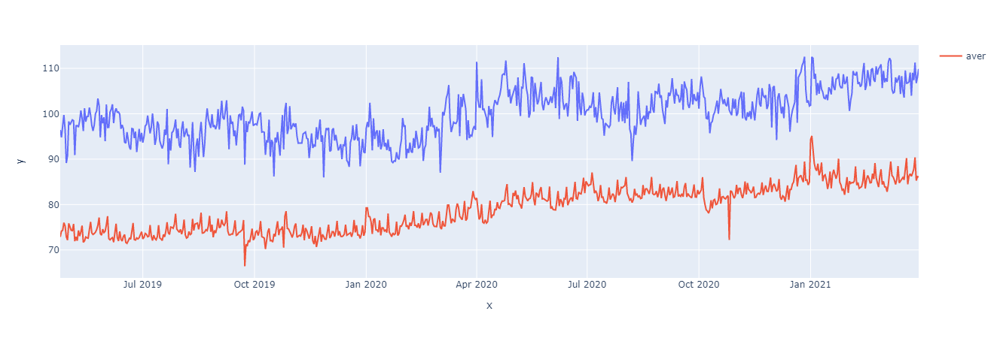

Муниципальные районы и городские округа Ханты-Мансийского автономного округа - Югры


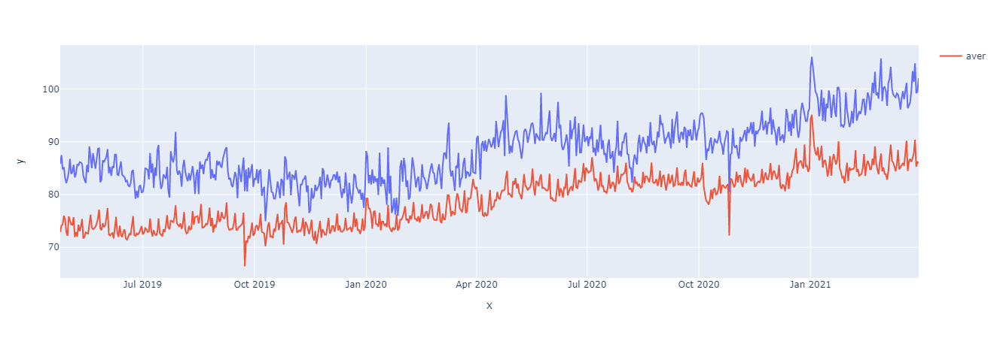

Муниципальные образования Чукотского автономного округа


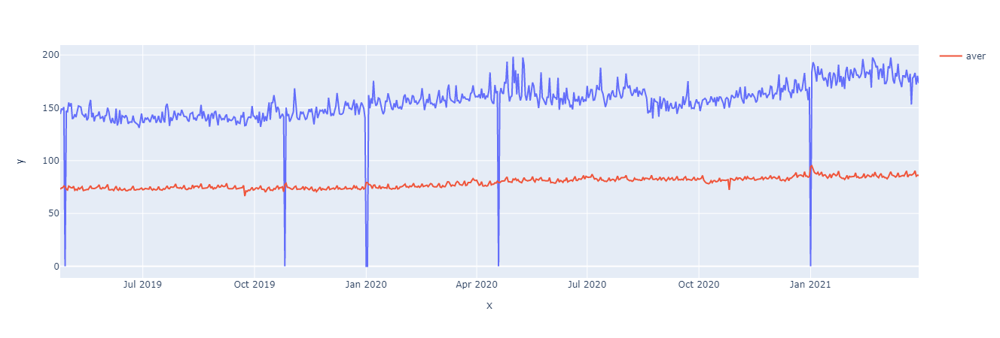

Муниципальные образования Республики Башкортостан


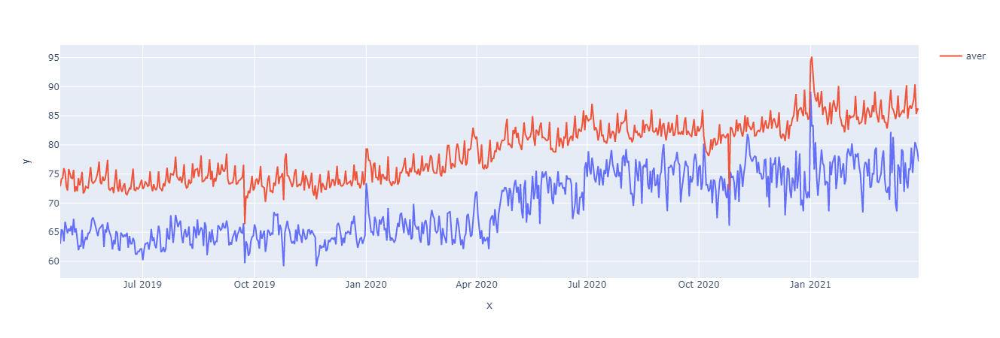

Муниципальные образования Республики Алтай


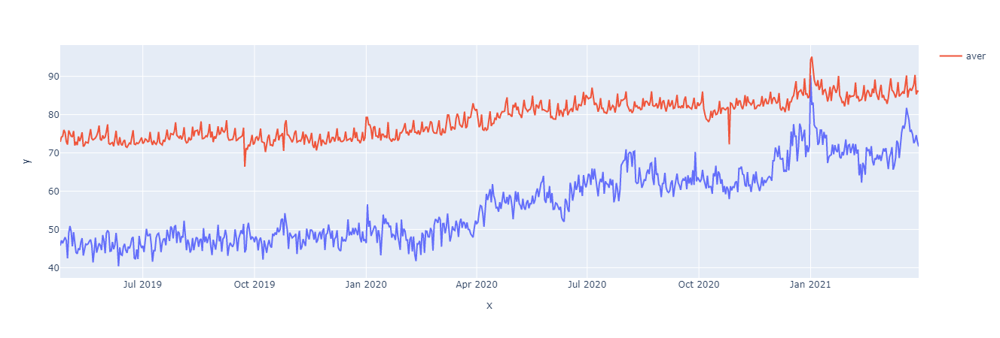

Муниципальные образования Республики Адыгеи (Адыгеи)


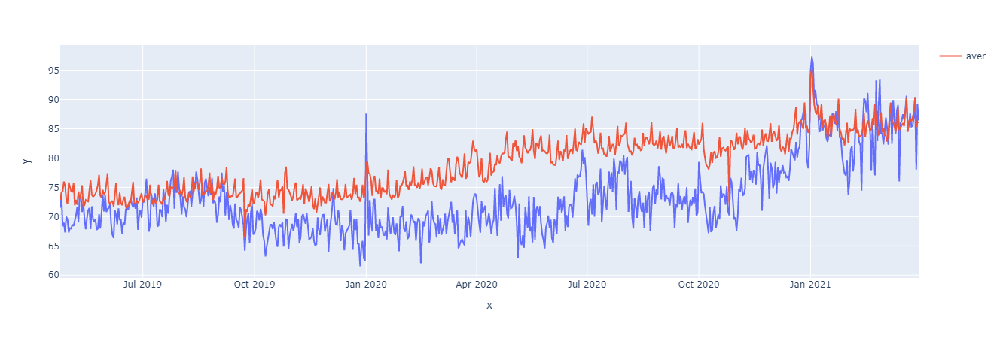

Муниципальные образования Республики Бурятии


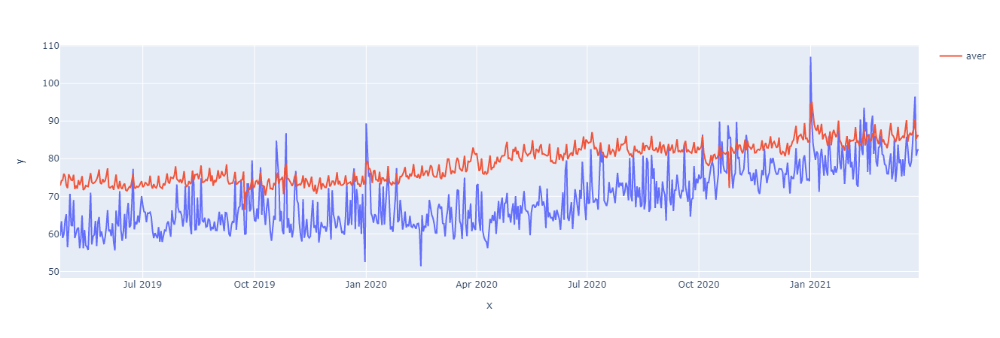

Муниципальные образования Республики Дагестан


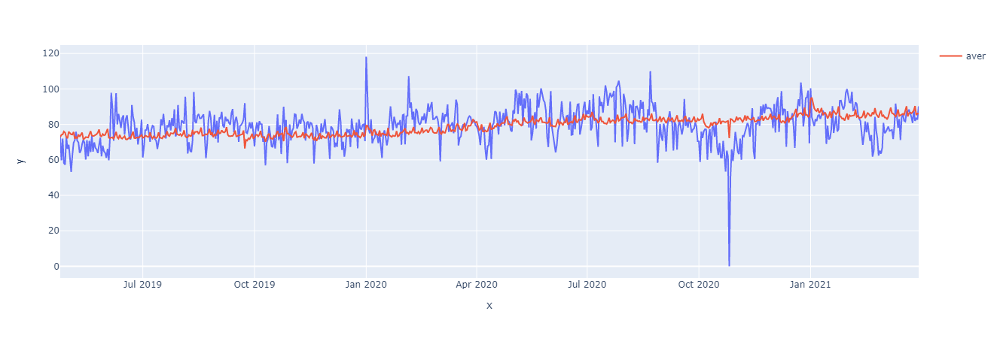

Муниципальные образования Республики Калмыкии


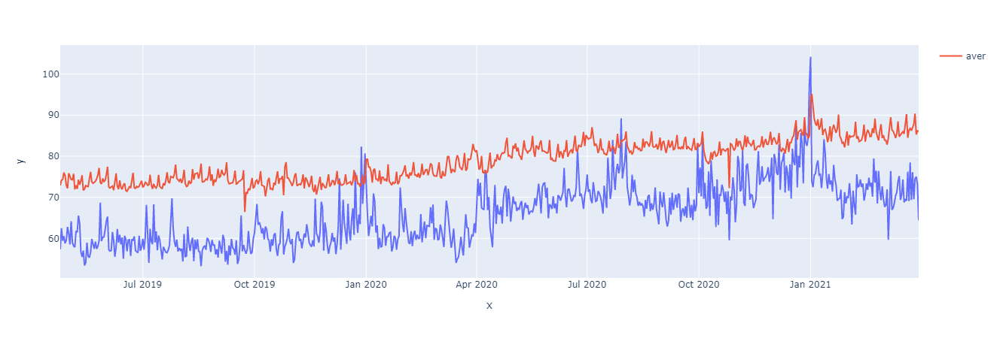

Муниципальные образования Кабардино-Балкарской Республики


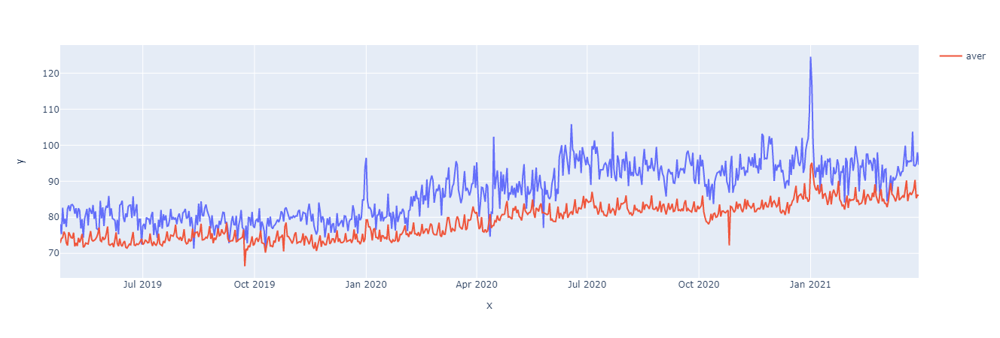

Муниципальные образования Республики Ингушетии


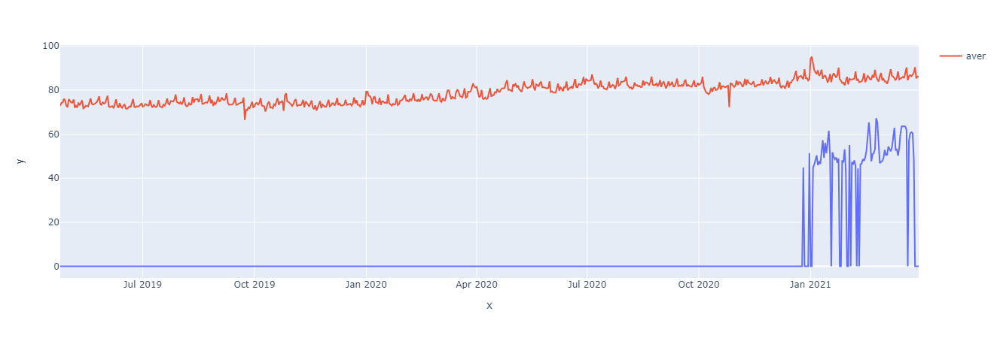

Муниципальные образования Республики Саха (Якутия)


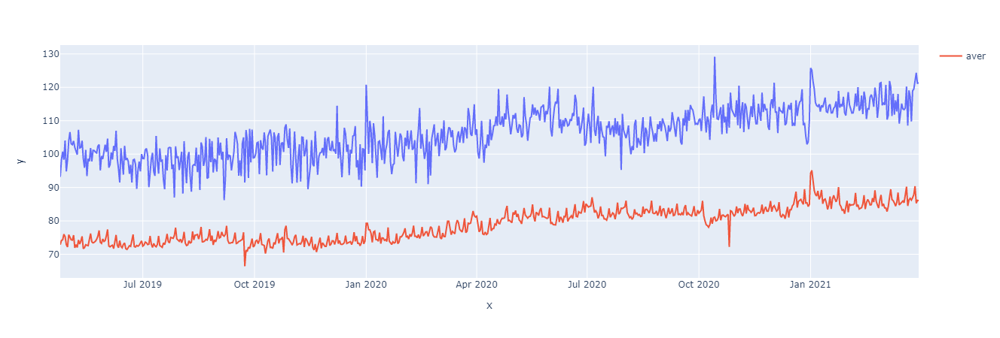

Муниципальные образования Республики Татарстан (Татарстана)


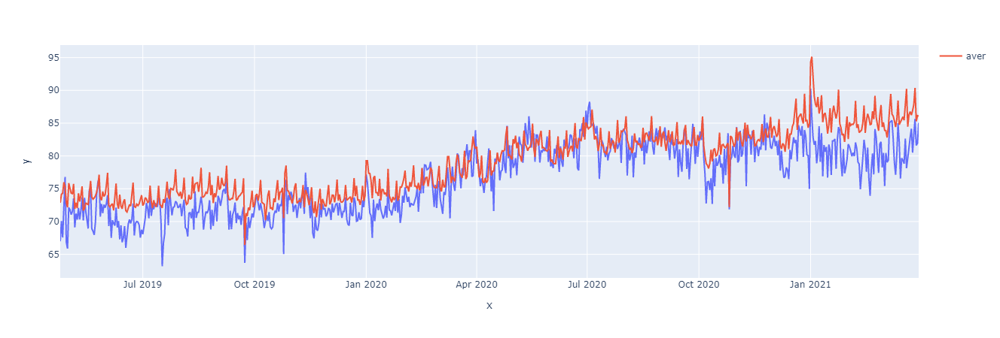

Муниципальные образования Республики Северная Осетия-Алания


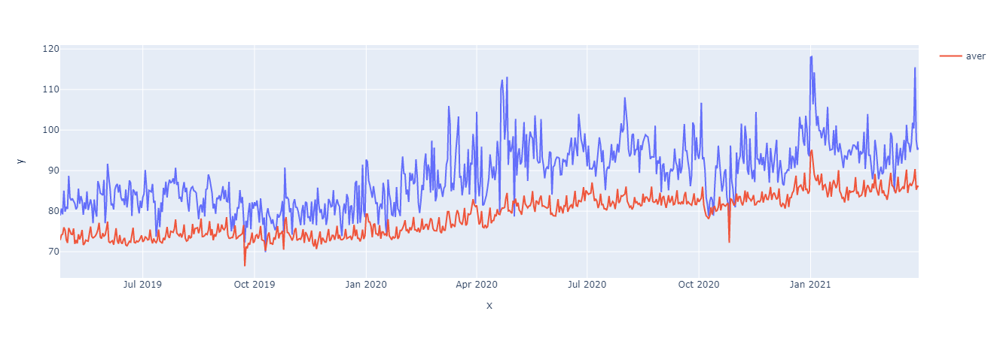

Муниципальные образования Республики Тывы


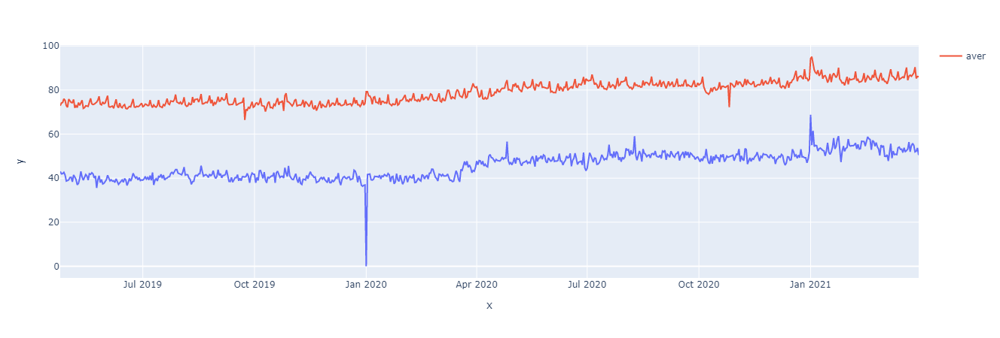

Муниципальные образования Республики Мордовии


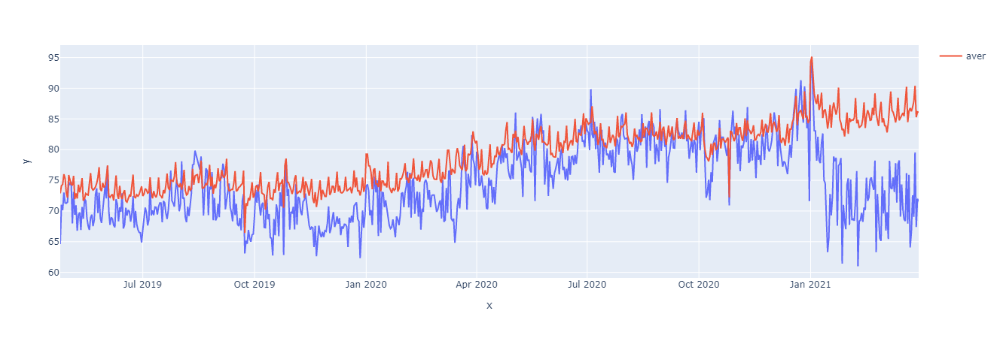

Муниципальные образования Чеченской Республики


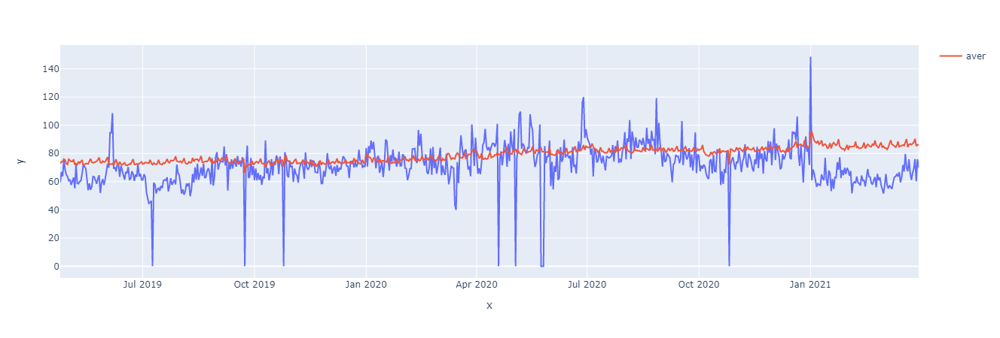

Муниципальные образования Удмуртской Республики


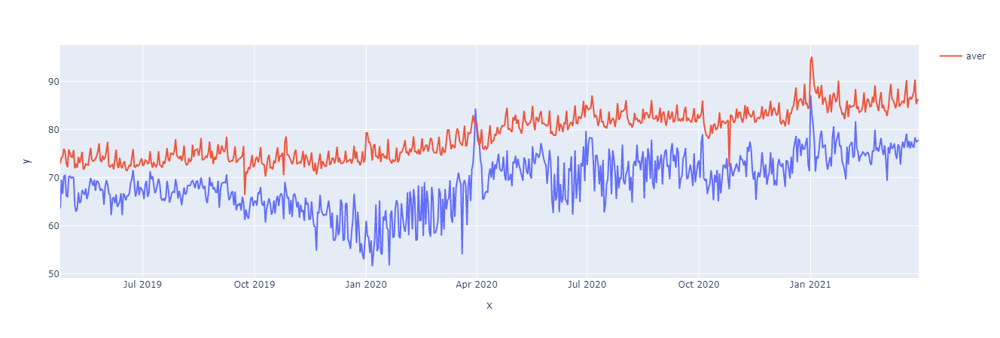

Муниципальные образования Республики Хакасии


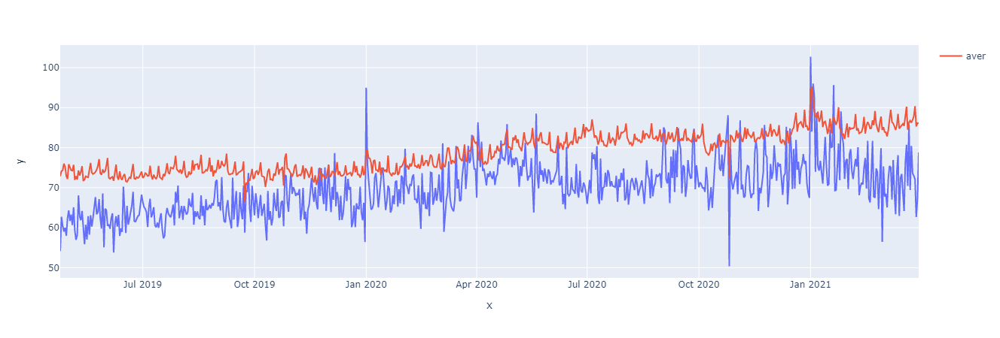

Муниципальные образования Карачаево-Черкесской Республики


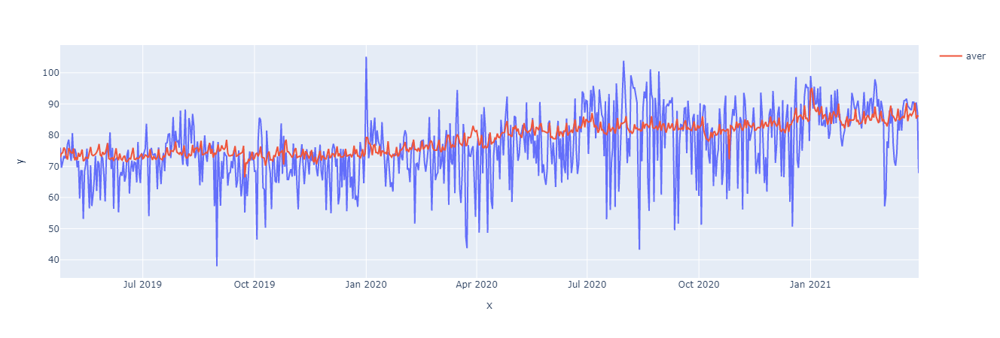

Муниципальные образования Республики Коми


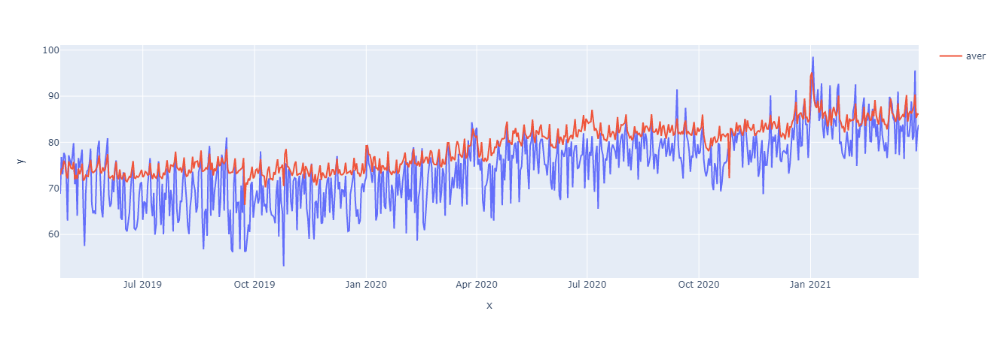

Муниципальные образования Республики Карелии


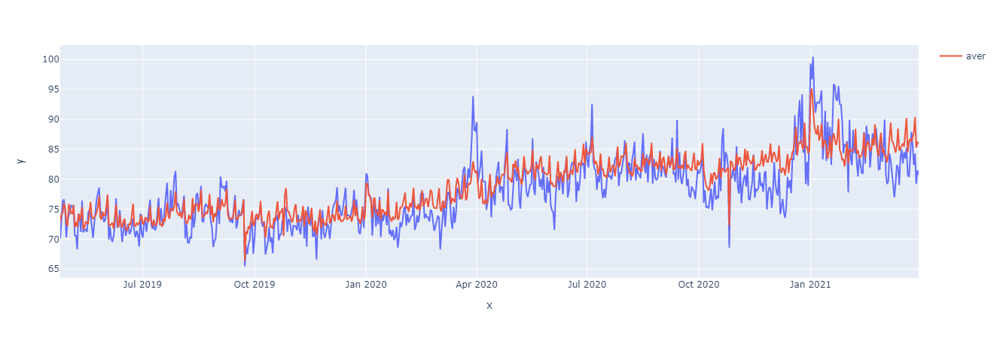

Муниципальные образования Республики Марий Эл


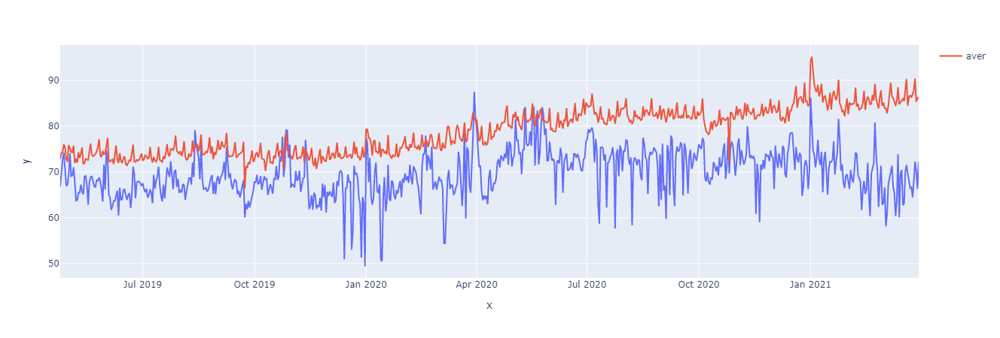

Муниципальные образования Краснодарского края


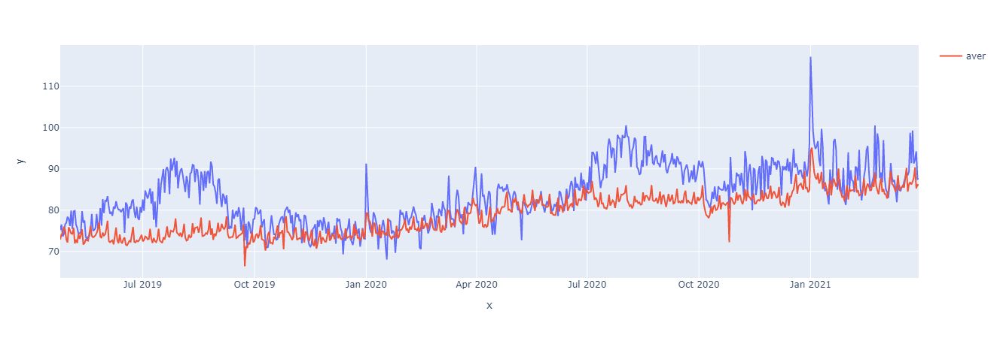

Муниципальные образования Красноярского края


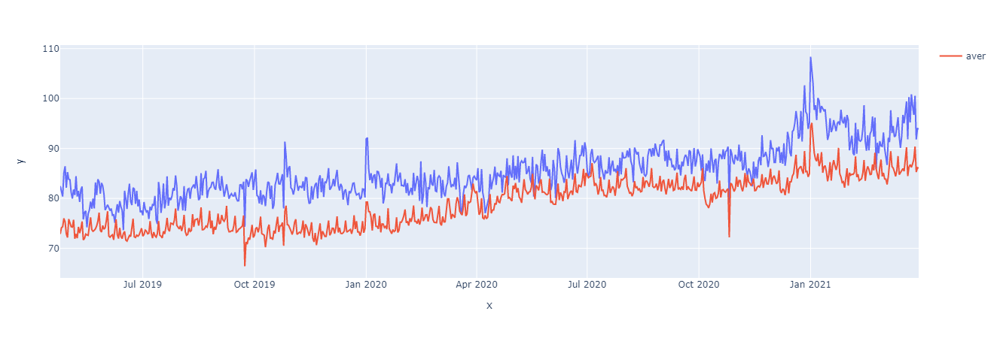

Муниципальные образования Чувашской Республики - Чувашии


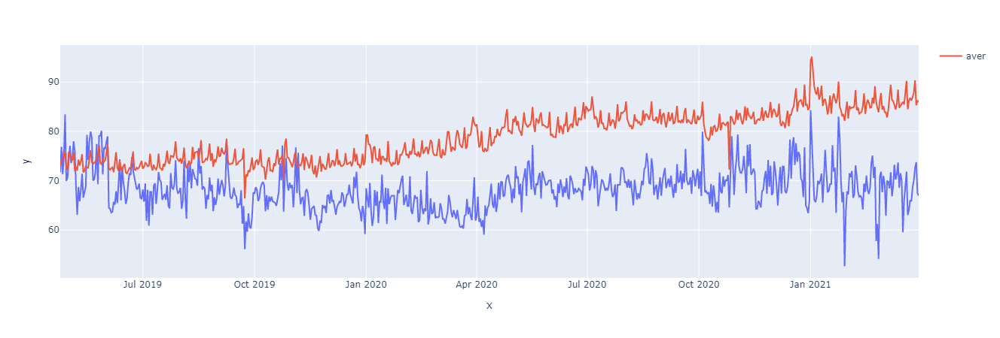

Муниципальные образования Алтайского края


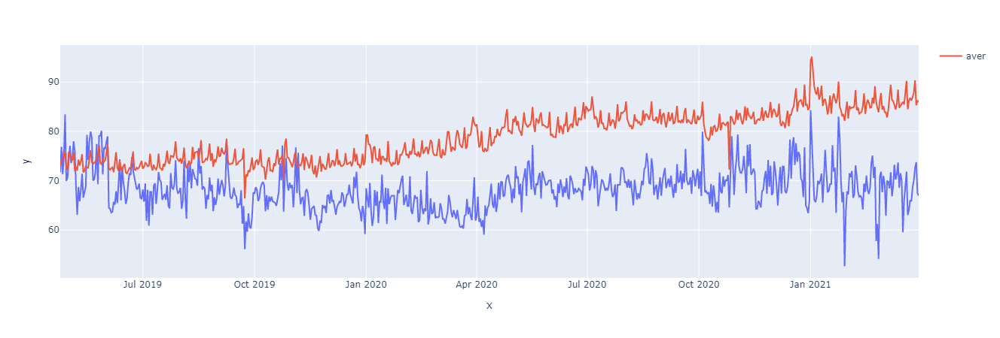

Муниципальные образования Приморского края


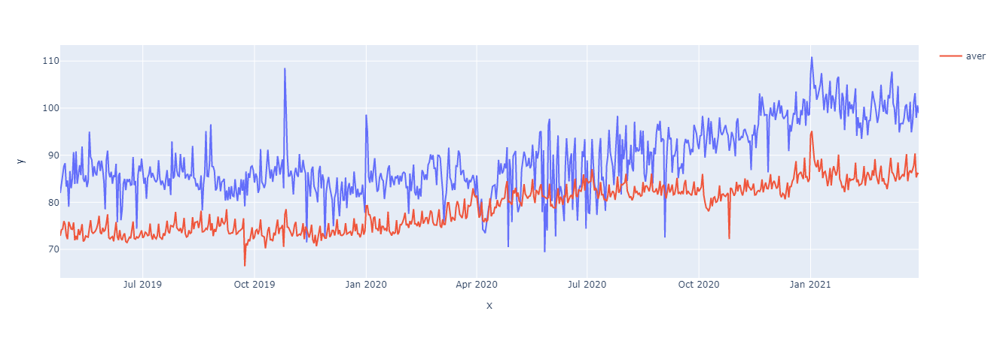

Муниципальные образования Самарской области


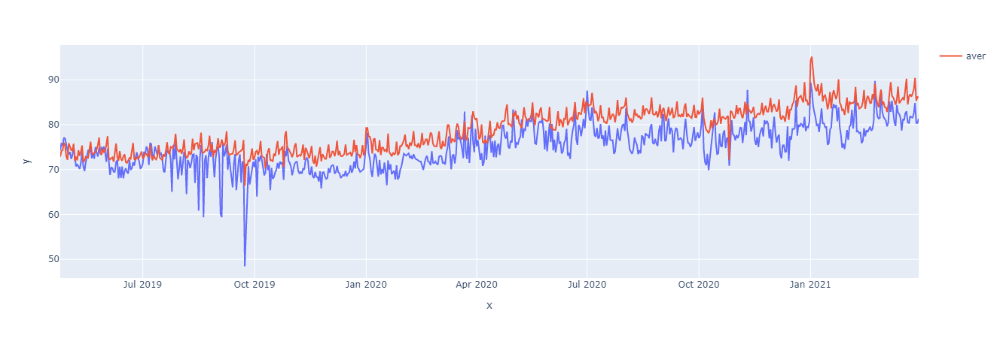

Муниципальные образования Рязанской области


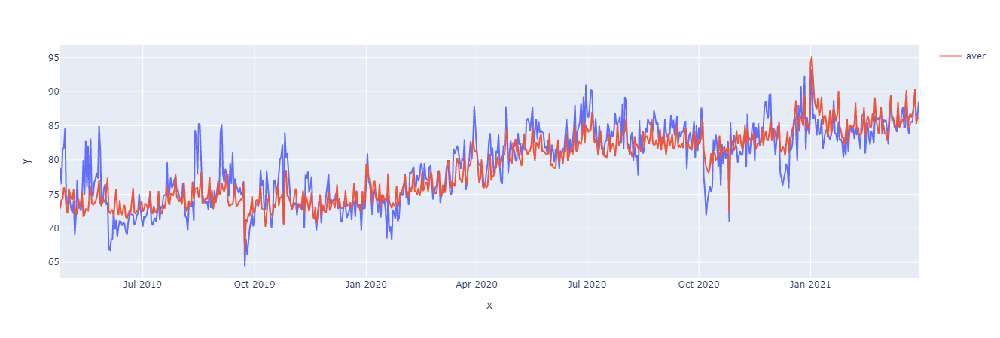

Муниципальные образования Ростовской области


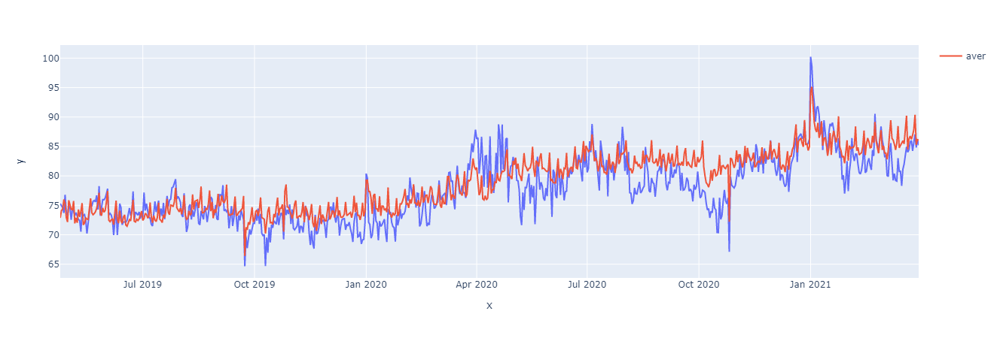

Муниципальные образования Псковской области


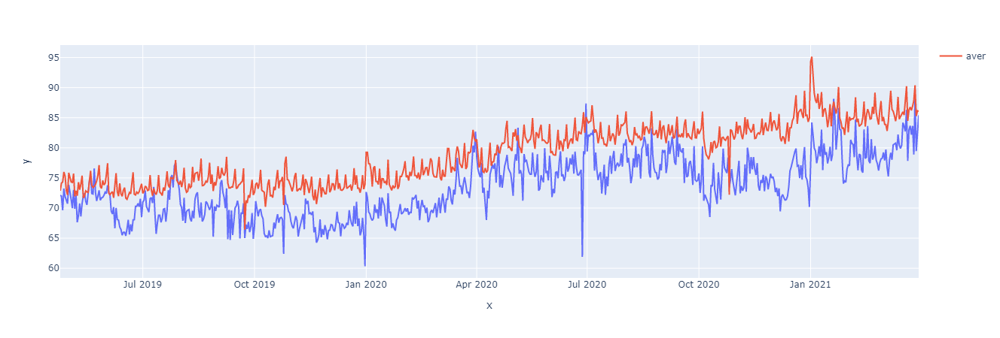

Муниципальные образования Камчатского края


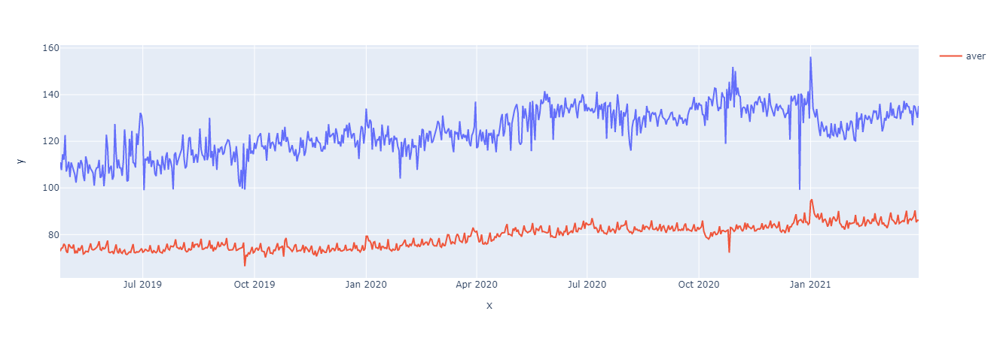

Муниципальные образования Калининградской области


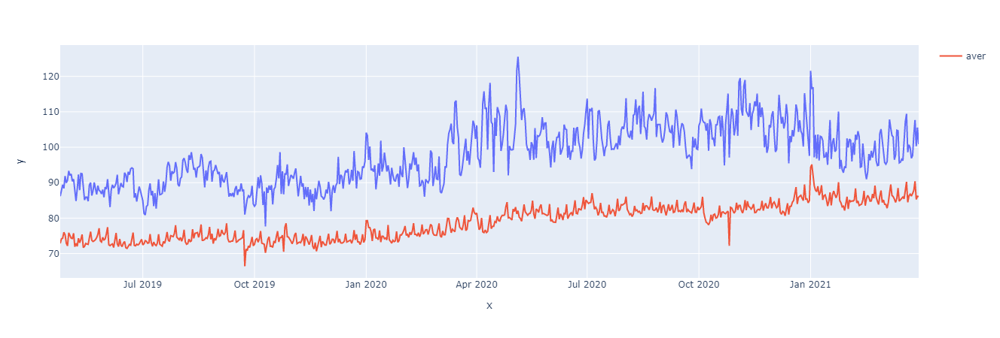

Муниципальные образования Кемеровской области - Кузбасса


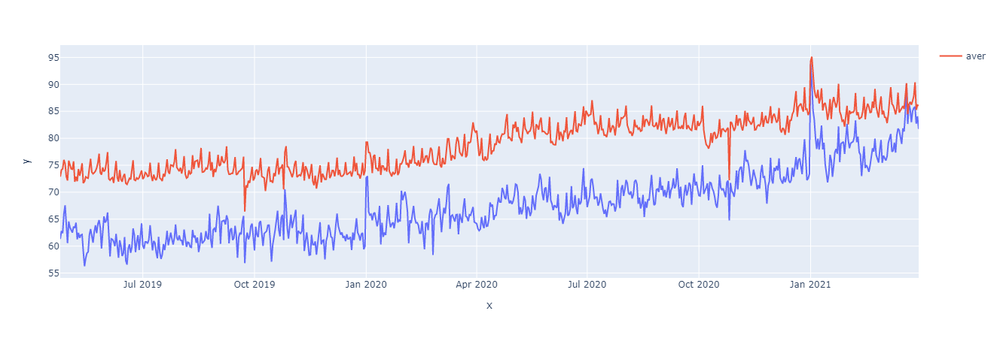

Муниципальные образования Калужской области


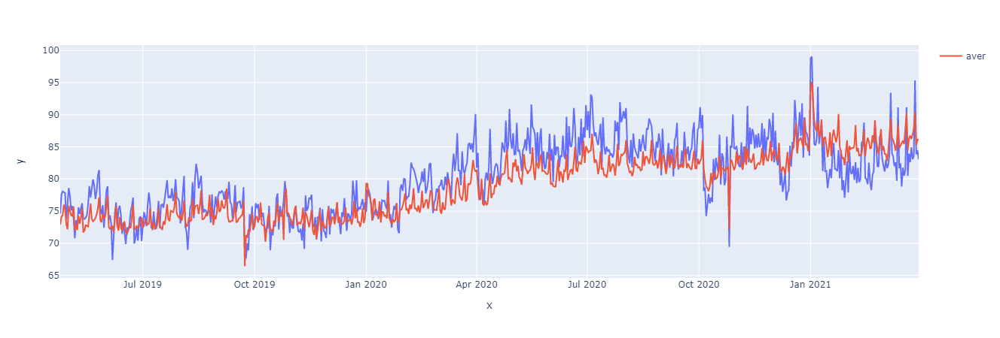

Муниципальные образования Курской области


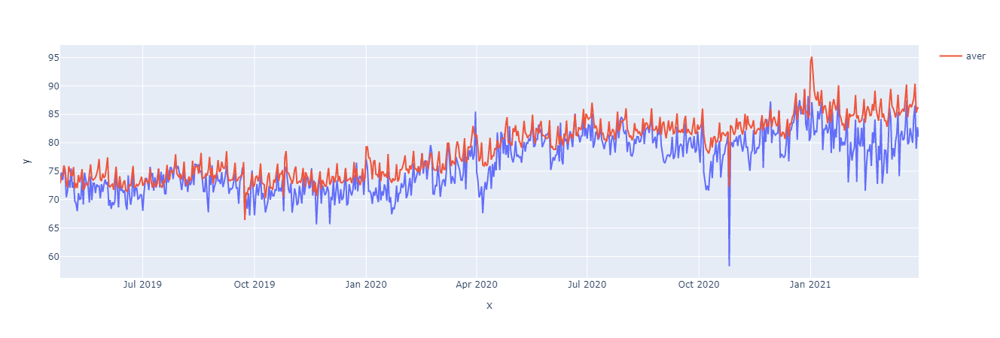

Муниципальные образования Костромской области


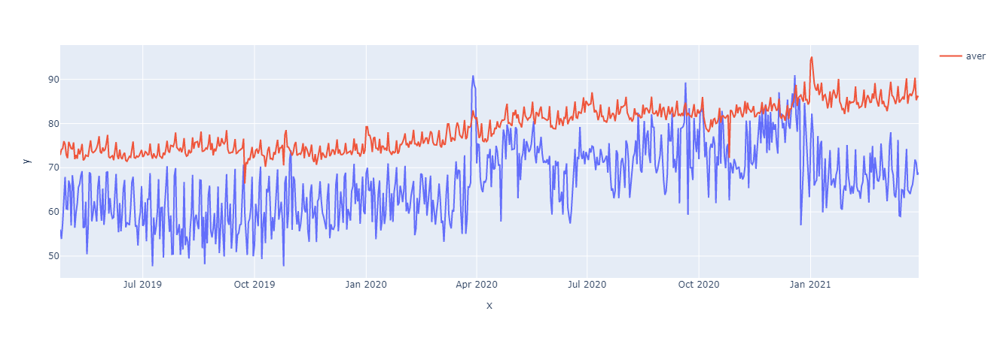

Муниципальные образования Курганской области


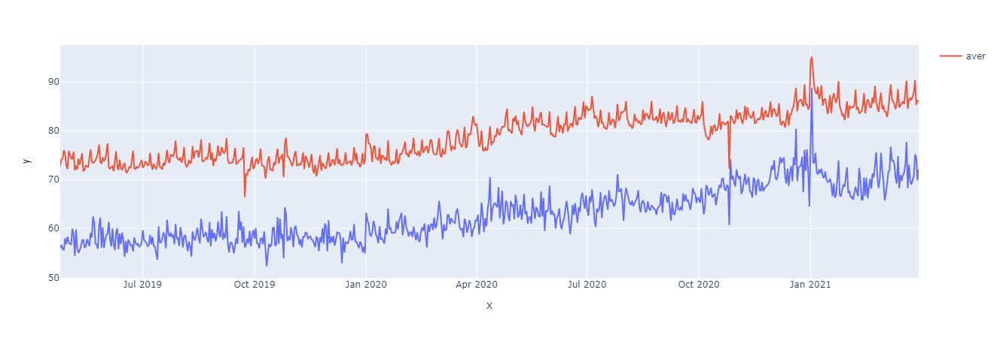

Муниципальные образования Кировской области


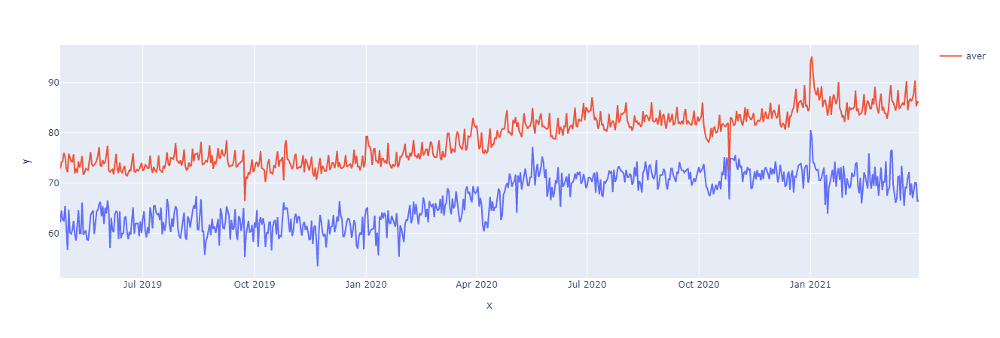

Муниципальные образования города федерального значения Севастополя


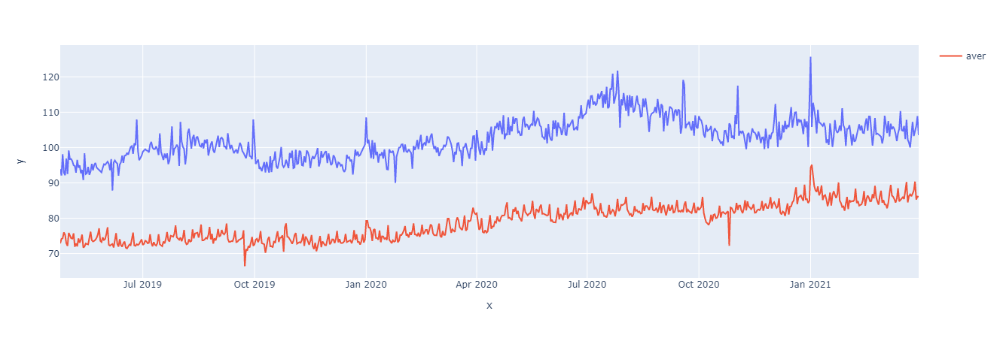

Муниципальные образования Тверской области


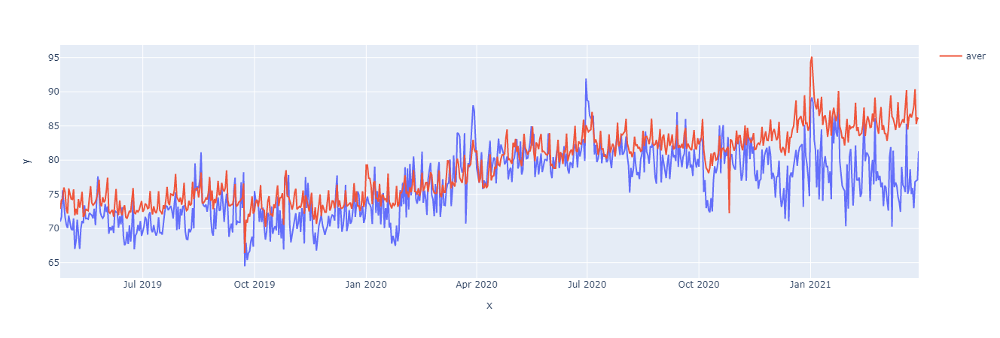

Муниципальные образования Томской области


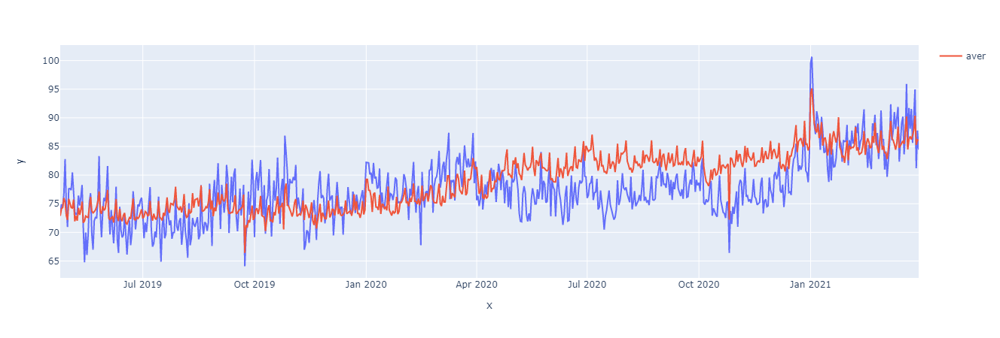

Муниципальные образования Тульской области


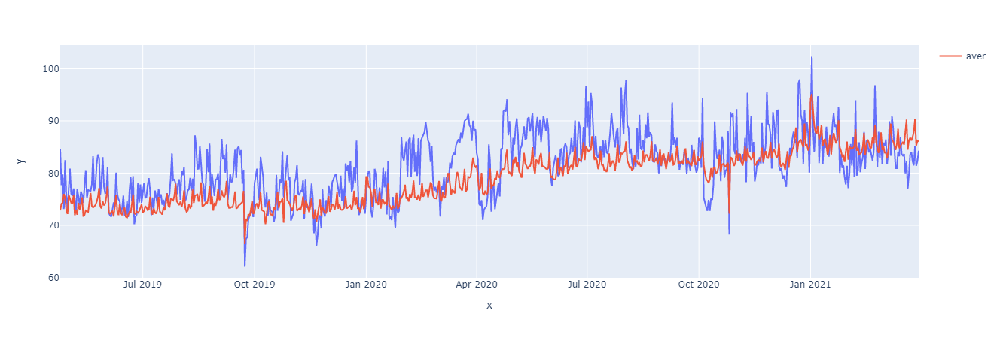

Муниципальные образования Тамбовской области


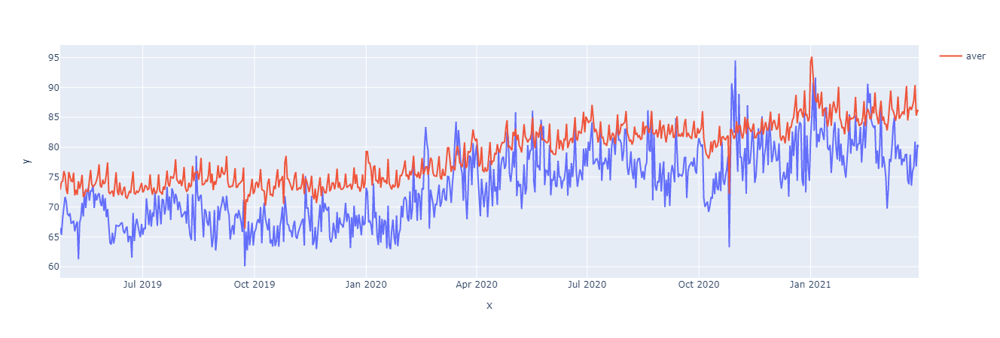

Муниципальные образования Ленинградской области


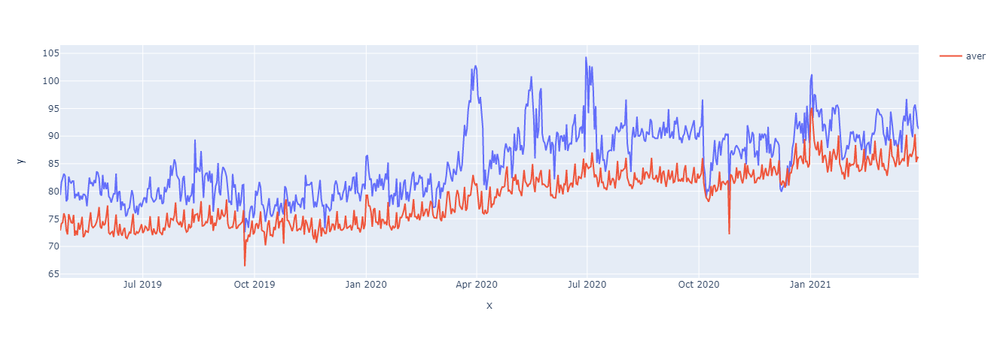

Муниципальные образования Московской области


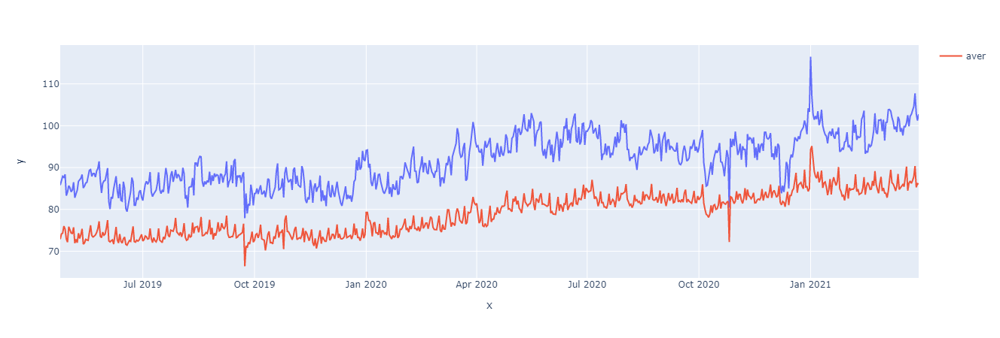

Муниципальные образования Магаданской области


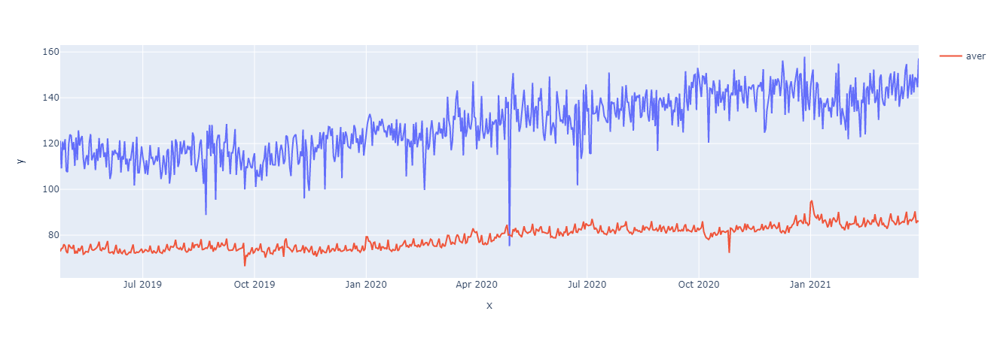

Муниципальные образования Липецкой области


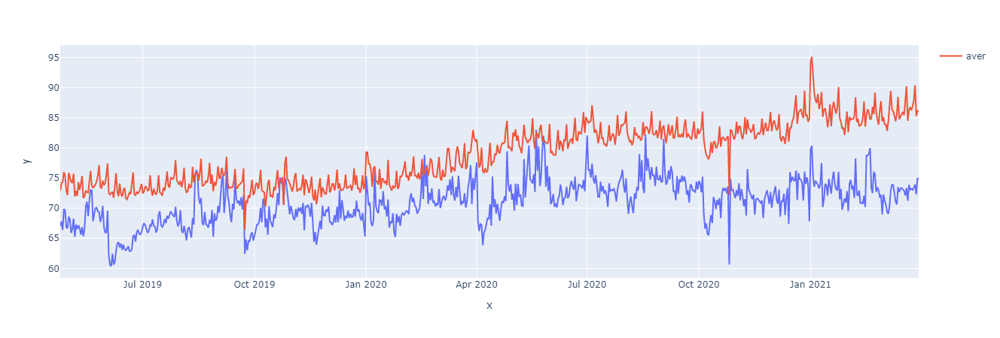

Муниципальные образования Архангельской области


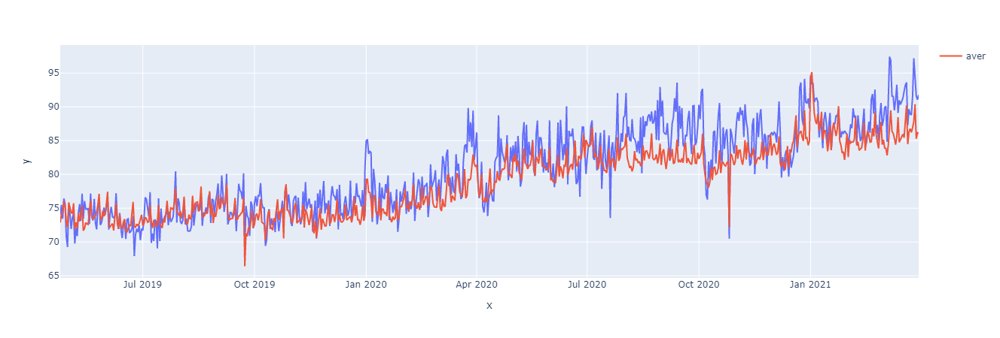

Муниципальные образования Амурской области


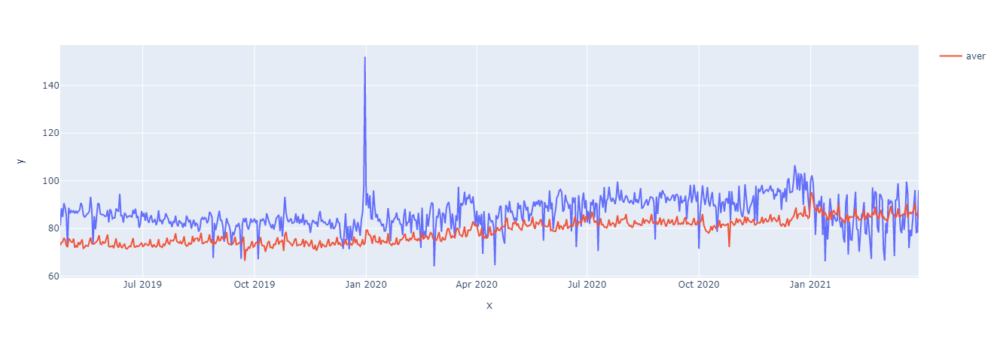

Муниципальные образования Хабаровского края


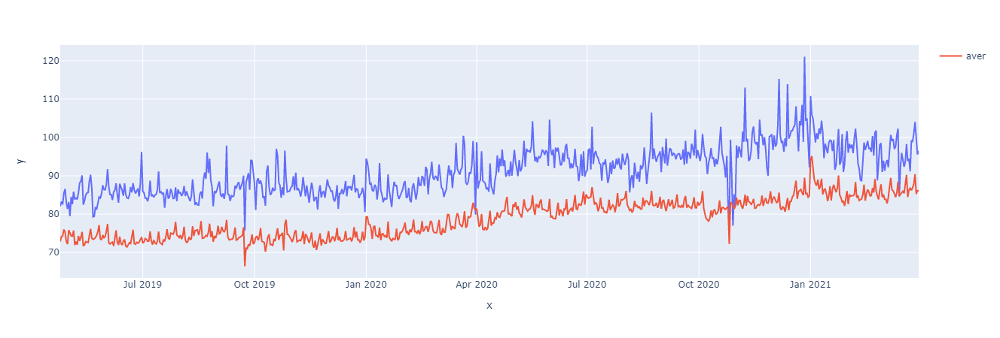

Муниципальные образования Ставропольского края


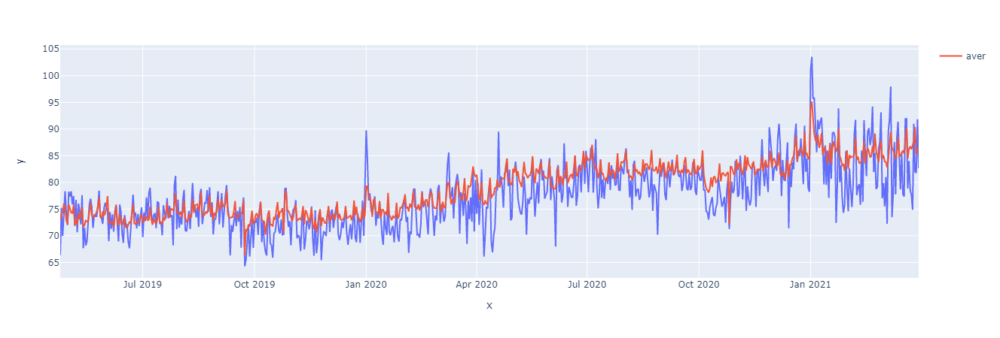

Муниципальные образования Ивановской области


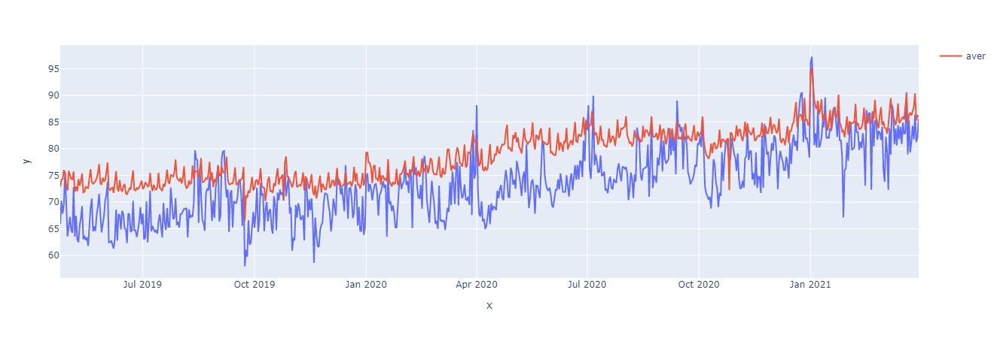

Муниципальные образования Вологодской области


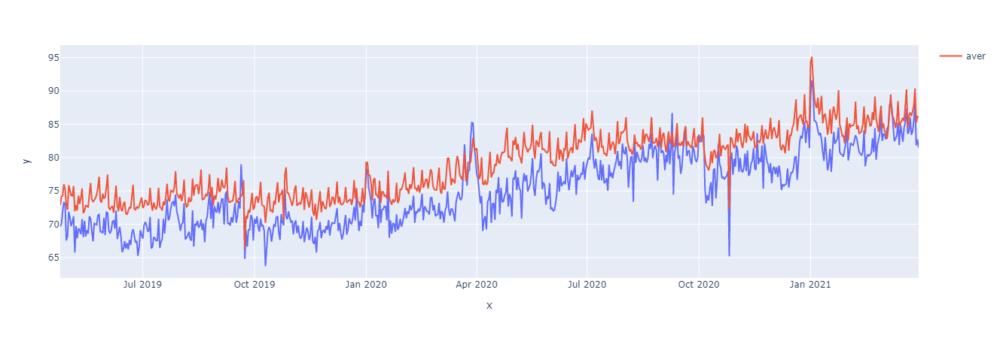

Муниципальные образования Волгоградской области


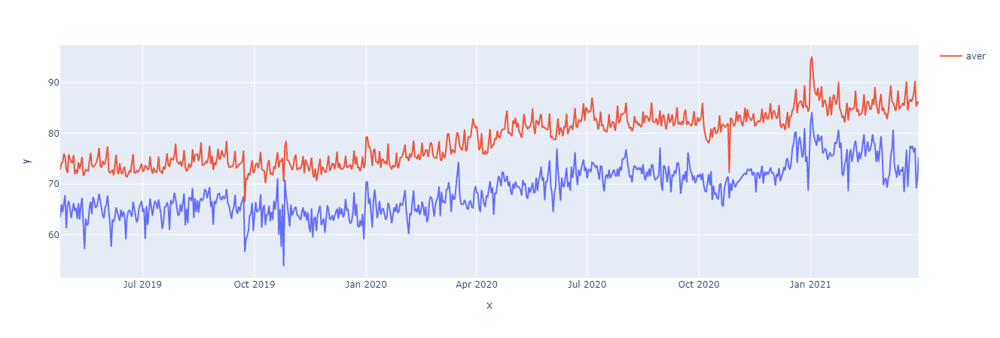

Муниципальные образования Воронежской области


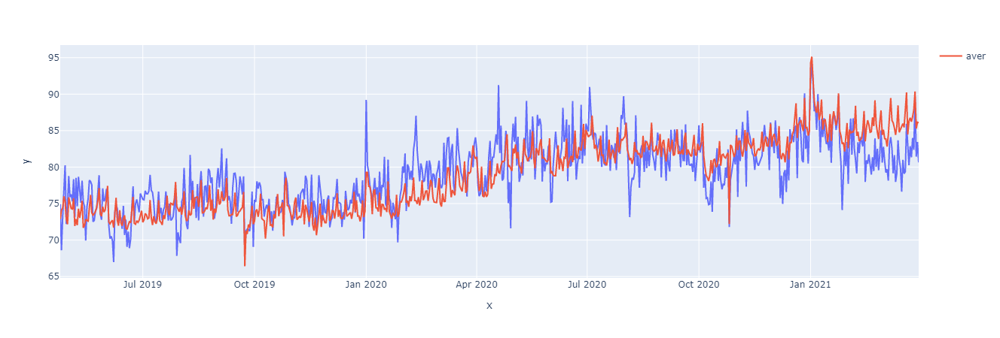

Муниципальные образования Иркутской области


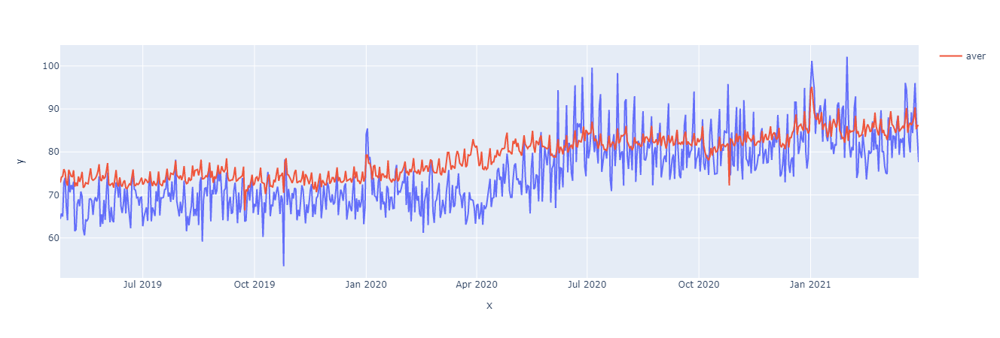

Муниципальные образования Орловской области


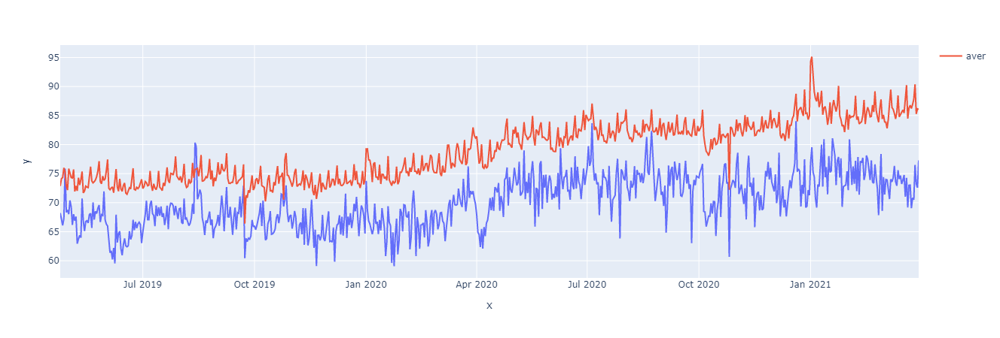

Муниципальные образования Омской области


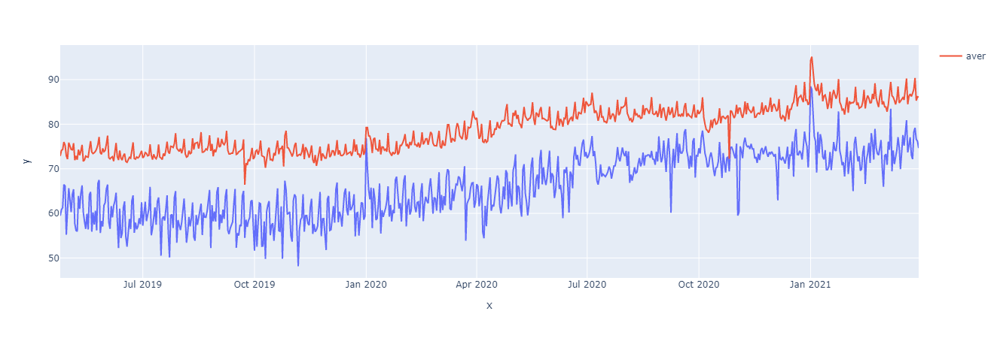

Муниципальные образования Оренбургской области


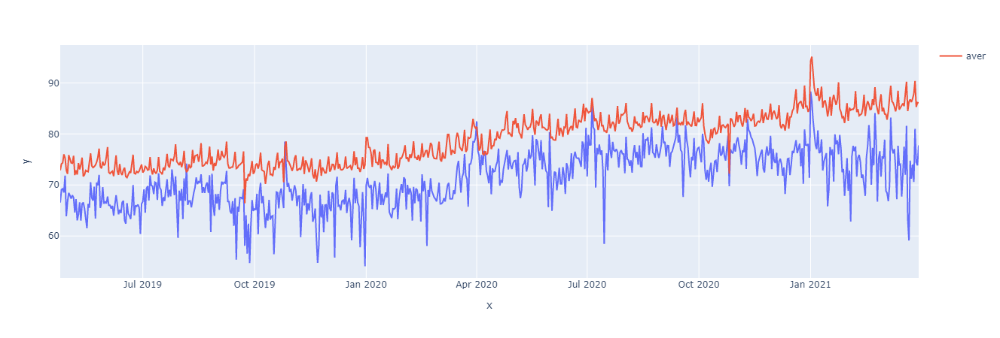

Муниципальные образования Пензенской области


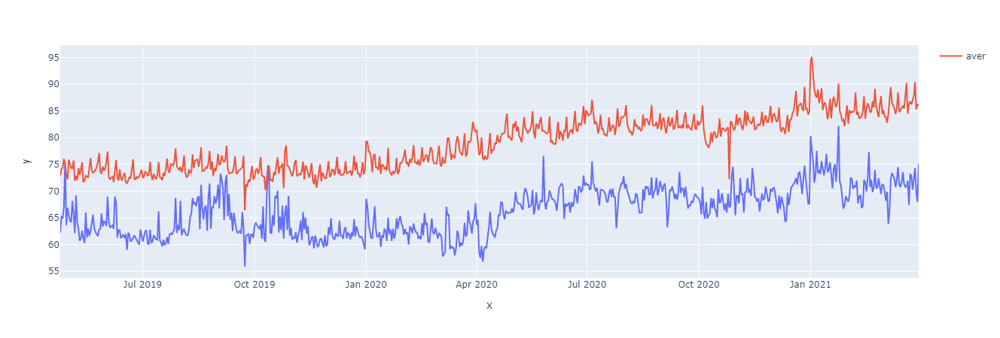

Муниципальные образования Пермского края


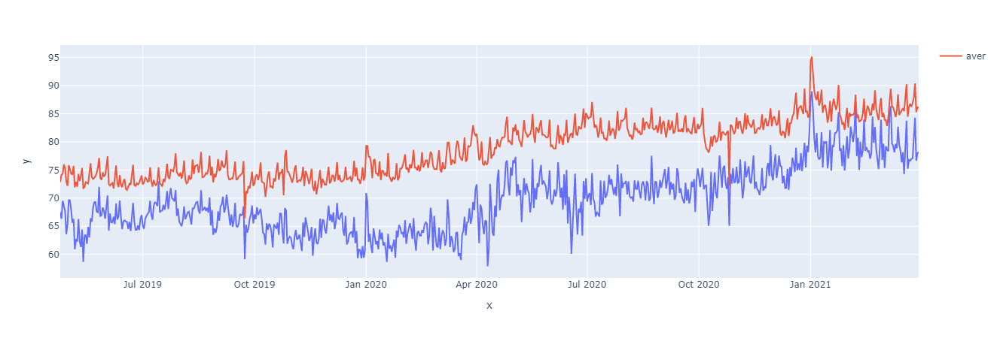

In [20]:
graph_research(items[0])

# Корреляция

In [21]:
%%time

#!!!!! CATCH WARNING AS ERROR


corr_df = pd.DataFrame(columns = ['region'] + list(items), index = oktmo)
corr_df['region'] = corr_df.index.map(lambda x: oktmo_names[x])

for el in items:

    use_cols = ['oktmo', 'date'] + [el]
    #Xsum = train[use_cols].groupby('date').sum().sort_values(by='date')
    Xaver = train[use_cols].groupby('date').mean().sort_values(by='date')


    for reg_id in oktmo:

        X = train[use_cols].query('oktmo == @reg_id').sort_values(by='date')
        corr_sp = sts.spearmanr(Xaver[el].values, 
                           X[el].values, 
                            axis = 1) 
        
        corr_df.loc[reg_id, el] = corr_sp.correlation
        


C:\Users\_v010ch_\Anaconda3\lib\site-packages\scipy\stats\stats.py:4490: SpearmanRConstantInputWarning:

An input array is constant; the correlation coefficient is not defined.



Wall time: 35.2 s


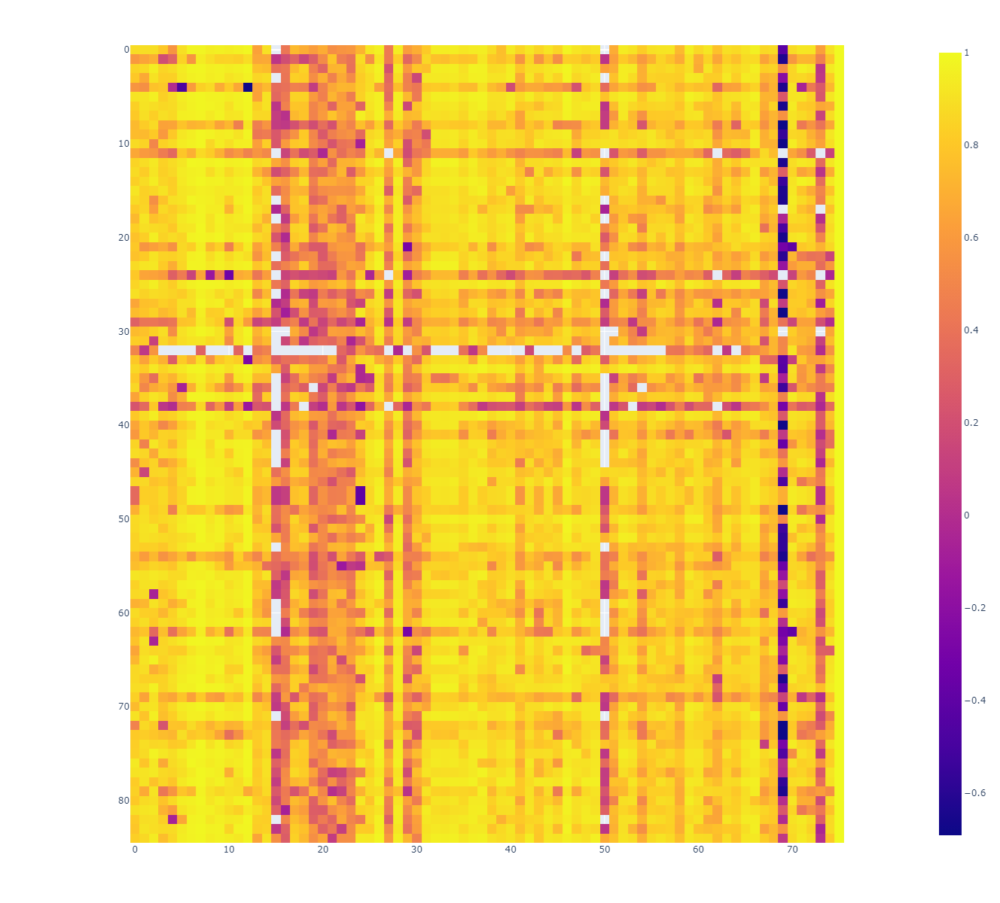

In [22]:
fig = px.imshow(corr_df.drop(['region'], axis = 1).values,
               width=1200, height=1200)
#fig.update_layout(
#    xaxis = dict(
#        tickmode = 'array',
#       tickvals = corr_df.drop(['region'], axis = 1).columns,
#        ticktext = corr_df.drop(['region'], axis = 1).columns
#   )
#
fig.show()

In [23]:
#corr_df

!!! файл notes.xlsx пересоздается здесь

In [35]:
with pd.ExcelWriter(os.path.join(Path.cwd(), 'notes.xlsx'), engine="openpyxl") as writer:  
    corr_df.to_excel(writer,
                 sheet_name = 'corr')
    

### Нули

In [25]:
%%time
ttl = len(train.date.unique())

zeros_df = pd.DataFrame(columns = ['region'] + list(items), index = oktmo)
zeros_df['region'] = zeros_df.index.map(lambda x: oktmo_names[x])

for item, el in product(items, oktmo):
    #zeros_values = train.query('oktmo == @el and @item == 0').pasta.shape[0]
    zeros_values = sum(train.query('oktmo == @el')[item] == 0)
    zeros_df.loc[el, item] = zeros_values/ttl
    #if zeros_values > 0:
    #    print(f'{zeros_values/ttl:.04f}', oktmo_names[el])
    #break

Wall time: 35.7 s


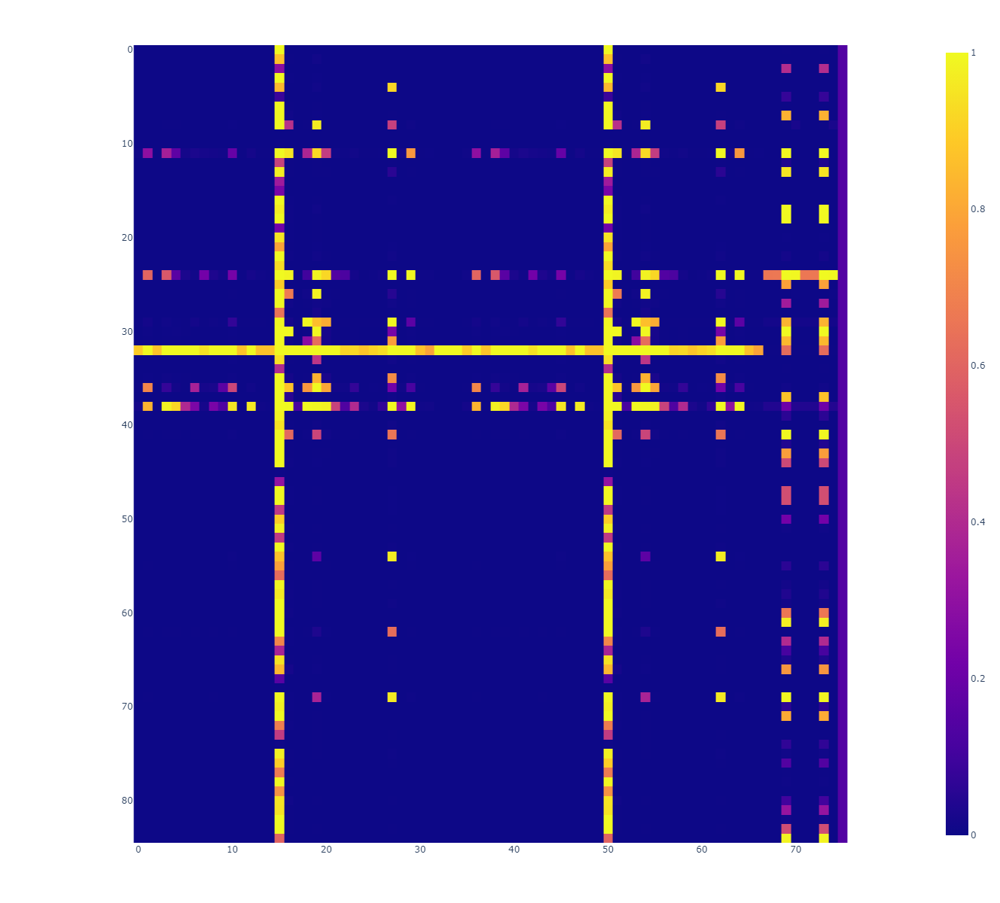

In [26]:
fig = px.imshow(zeros_df.drop(['region'], axis = 1).values,
               width=1200, height=1200)

fig.show()

In [36]:
with pd.ExcelWriter(os.path.join(Path.cwd(), 'notes.xlsx'), mode='a', engine="openpyxl") as writer:  
    zeros_df.to_excel(writer,
                 sheet_name = 'zeros')

### Пропуски в датах

In [28]:
aver_date = set(train.groupby(['date']).agg(['mean']).reset_index()[['date', 'pasta']].date)